# Datos del estudiante
### Nombre: Jonnathan Campoberde
### Materia: Minería de Datos
### Curso: Abril 2024-2025

# Introducción

En la presente actividad se usaran los pasos recomendados en la metodología KDD (Knowledge Discovery in Databases) con el objetivo de crear un modelo de machine learning para clasificar pacientes según la presencia de SIDA.

# Fases del Proyecto según KDD

# Fase 1: Comprensión del Negocio y Definición del Problema

### Definición del Problema: 
Identificar las caracteristicas que clasifican a los pacientes que tienen SIDA, con el objetivo de realizar un modelo de machine learning que pueda ser usado por las personas del sector de la salud a identificar de una mejor manera a dichos pacientes.

### Análisis del Contexto: 
Evaluar el contexto médico, incluyendo la prevalencia del SIDA, factores de riesgo, tratamientos actuales y datos disponibles para el análisis.

# Fase 2: Comprensión de los Datos

## Recopilación de Datos
Los datos recolectados que van a ser usados a lo largo del analisis contienen estadísticas de atención médica e información categórica sobre pacientes que han sido diagnosticados con SIDA. Este conjunto de datos fue publicado inicialmente en 1996. Enlace al dataset https://www.kaggle.com/datasets/aadarshvelu/aids-virus-infection-prediction/data

#### Descripción del dataset seleccionado

| **Atributo**  | **Descripción**                                                                                                                                       |
|:--------------|:-------------------------------------------------------------------------------------------------------------------------------------------------------|
| **time**      | Tiempo hasta la insuficiencia hepática en días                                                                                                                   |
| **trt**       | Indicador de tratamiento:                                                                                                                              |
|               | 0 = solo ZDV (Zidouvina, medicamento para el tratamiento por VIH=                                                                                                                                           |
|               | 1 = ZDV + ddI (Zidouvina + Lamivudina)                                                                                                                                          |
|               | 2 = ZDV + Zal (Zidouvina + Zalcitabina )                                                                                                                                         |
|               | 3 = solo ddI (Lamivudina)                                                                                                                                          |
| **age**       | Edad (años) al inicio                                                                                                                                  |
| **wtkg**      | Peso (kg) al inicio                                                                                                                                    |
| **hemo**      | Hemofilia:                                                                                                                                             |
|               | 0 = no                                                                                                                                                |
|               | 1 = sí                                                                                                                                                |
| **homo**      | Actividad homosexual:                                                                                                                                  |
|               | 0 = no                                                                                                                                                |
|               | 1 = sí                                                                                                                                                |
| **drugs**     | Historial de uso de drogas intravenosas:                                                                                                               |
|               | 0 = no                                                                                                                                                |
|               | 1 = sí                                                                                                                                                |
| **karnof**    | Puntuación de Karnofsky para expresar de forma reducida el estado de salud y calidad de vidad de un paciente (en una escala de 0-100)                                                                                                       |
| **oprior**    | Terapia antirretroviral no ZDV (Zidouvina) antes de 175:                                                                                                           |
|               | 0 = no                                                                                                                                                |
|               | 1 = sí                                                                                                                                                |
| **z30**       | ZDV (Zidouvina) en los 30 días previos a 175:                                                                                                                      |
|               | 0 = no                                                                                                                                                |
|               | 1 = sí                                                                                                                                                |
| **preanti**   | Días de terapia antirretroviral antes de 175                                                                                                           |
| **race**      | Raza:                                                                                                                                                  |
|               | 0 = Blanco                                                                                                                                            |
|               | 1 = no blanco                                                                                                                                         |
| **gender**    | Género:                                                                                                                                                |
|               | 0 = F                                                                                                                                                 |
|               | 1 = M                                                                                                                                                 |
| **str2**      | Historial antirretroviral:                                                                                                                             |
|               | 0 = novato                                                                                                                                             |
|               | 1 = experimentado                                                                                                                                      |
| **strat**     | Estratificación del historial antirretroviral:                                                                                                         |
|               | 1 = Novato en antirretrovirales                                                                                                                        |
|               | 2 = > 1 pero <= 52 semanas de terapia antirretroviral previa                                                                                           |
|               | 3 = > 52 semanas                                                                                                                                       |
| **symptom**   | Indicador sintomático:                                                                                                                                 |
|               | 0 = asintomático                                                                                                                                       |
|               | 1 = sintomático                                                                                                                                        |
| **treat**     | Indicador de tratamiento:                                                                                                                              |
|               | 0 = solo ZDV                                                                                                                                           |
|               | 1 = otros                                                                                                                                              |
| **offtrt**    | Indicador de fuera de tratamiento antes de 96+/-5 semanas:                                                                                             |
|               | 0 = no                                                                                                                                                 |
|               | 1 = sí                                                                                                                                                 |
| **cd40**      | CD4 (linfocitos CD4) al inicio                                                                                                                                          |
| **cd420**     | CD4 (linfocitos CD4) a las 20+/-5 semanas                                                                                                                               |
| **cd80**      | CD8 (linfocitos CD8) al inicio                                                                                                                                          |
| **cd820**     | CD8 (linfocitos CD8) a las 20+/-5 semanas                                                                                                                               |
| **infected**  | Está infectado con SIDA:                                                                                                                               |
|               | 0 = No                                                                                                                                                |
|               | 1 = Sí                                                                                                                                                |

## Exploración de Datos Preliminar
Un análisis exploratorio para comprender la estructura y la calidad de los datos, identificar posibles sesgos y evaluar la idoneidad de los datos para el modelado.


### Importación de librerías necesarias para el análisis

In [1]:
# Se importan las librerias necesarias y configuraciones globales para el desarrollo de la actividad
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import chi2_contingency, fisher_exact
from statsmodels.stats.outliers_influence import variance_inflation_factor
import statsmodels.api as sm
import plotly.express as px
from sklearn.preprocessing import RobustScaler
from sklearn.model_selection import train_test_split,GridSearchCV, KFold,cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score,confusion_matrix, ConfusionMatrixDisplay,precision_score,recall_score,f1_score,roc_auc_score,roc_curve
from imblearn.combine import SMOTEENN
from imblearn.under_sampling import NearMiss
from sklearn import tree
import graphviz

pd.set_option('display.max_columns', None)

In [2]:
#Cargar los datos del dataset al dataframe y mostrar los primeros 5 registros
aids_df = pd.read_csv('aids_clasification.csv')
#Mostrar los primeros 5 registros del dataframe
aids_df.head()

,time,trt,age,wtkg,hemo,homo,drugs,karnof,oprior,z30,preanti,race,gender,str2,strat,symptom,treat,offtrt,cd40,cd420,cd80,cd820,infected
0,948.0,2,48,89.8128,0,0,0.0,100.0,0.0,0,0.0,0,0,0,1,0,1,0,422.0,477.0,566.0,324.0,0
1,1002.0,3,61,49.4424,0,0,0.0,90.0,0.0,1,895.0,0,0,1,3,0,1,0,162.0,218.0,392.0,564.0,1
2,961.0,3,45,88.4520,0,1,1.0,90.0,0.0,1,707.0,0,1,1,3,0,1,1,326.0,274.0,2063.0,1893.0,0
3,1166.0,3,47,85.2768,0,1,0.0,100.0,0.0,1,1399.0,0,1,1,3,0,1,0,287.0,394.0,1590.0,966.0,0
4,1090.0,0,43,66.6792,0,1,0.0,100.0,0.0,1,1352.0,0,1,1,3,0,0,0,504.0,353.0,870.0,782.0,0


In [3]:
registros, columnas = (aids_df.shape)
print("El dataset contiene {registros} registros y {columnas} columnas.".format(registros=registros,columnas=columnas))

El dataset contiene 72151 registros y 23 columnas.


In [4]:
#Se imprime todas las columnas del dataset
print('Las columnas del dataset: {columnas}'.format(columnas=','.join(aids_df.columns.to_list())))

Las columnas del dataset: time,trt,age,wtkg,hemo,homo,drugs,karnof,oprior,z30,preanti,race,gender,str2,strat,symptom,treat,offtrt,cd40,cd420,cd80,cd820,infected


### Descripción de manera general de los tipos de variable para las columnas del dataframe 

In [5]:
aids_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 72151 entries, 0 to 72150
Data columns (total 23 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   time      72149 non-null  float64
 1   trt       72151 non-null  int64  
 2   age       72151 non-null  int64  
 3   wtkg      72144 non-null  float64
 4   hemo      72151 non-null  int64  
 5   homo      72151 non-null  int64  
 6   drugs     72150 non-null  float64
 7   karnof    72150 non-null  float64
 8   oprior    72150 non-null  float64
 9   z30       72151 non-null  int64  
 10  preanti   72148 non-null  float64
 11  race      72151 non-null  int64  
 12  gender    72151 non-null  int64  
 13  str2      72151 non-null  int64  
 14  strat     72151 non-null  int64  
 15  symptom   72151 non-null  int64  
 16  treat     72151 non-null  int64  
 17  offtrt    72151 non-null  int64  
 18  cd40      72150 non-null  float64
 19  cd420     72148 non-null  float64
 20  cd80      72150 non-null  fl

In [6]:
#Se muestra la cantidad de registros por columa que tienen valores nulos
pd.DataFrame(aids_df.isna().sum()).T.style.background_gradient()

,time,trt,age,wtkg,hemo,homo,drugs,karnof,oprior,z30,preanti,race,gender,str2,strat,symptom,treat,offtrt,cd40,cd420,cd80,cd820,infected
0,2,0,0,7,0,0,1,1,1,0,3,0,0,0,0,0,0,0,1,3,1,2,0


Se observa que el dataset tiene registros nulos en diversas columnas y en la columna wtkg(peso al inicio del diagnostico) existen 7 registro nulos que se debe de analizar en las etapas posteriores

### Verificar la cantidad de registros duplicados

In [7]:
aids_duplicated = aids_df[aids_df.duplicated()]
aids_duplicated

,time,trt,age,wtkg,hemo,homo,drugs,karnof,oprior,z30,preanti,race,gender,str2,strat,symptom,treat,offtrt,cd40,cd420,cd80,cd820,infected
96,1020.0,1,35,61.40000,0,0,1.0,100.0,0.0,0,0.0,0,0,0,1,1,1,1,266.0,350.0,462.0,378.0,0
217,1160.0,0,27,66.22560,0,1,0.0,100.0,0.0,0,0.0,0,1,0,1,0,0,0,420.0,410.0,990.0,1070.0,0
362,1089.0,3,43,85.73040,0,1,0.0,100.0,0.0,1,630.0,0,1,1,3,1,1,0,434.0,387.0,1688.0,1257.0,0
654,231.0,1,35,69.80000,0,1,0.0,100.0,0.0,0,0.0,1,1,0,1,0,1,1,221.0,252.0,702.0,1008.0,0
976,1034.0,0,36,69.31008,0,0,0.0,100.0,0.0,1,987.0,1,0,1,3,0,0,0,309.0,630.0,867.0,1259.0,0
1225,147.0,0,32,83.20000,0,1,1.0,90.0,0.0,1,7.0,1,1,0,1,0,0,1,234.0,108.0,1250.0,461.0,1
1427,1145.0,2,46,73.02960,0,1,0.0,100.0,0.0,1,925.0,0,1,1,3,0,1,0,280.0,330.0,1500.0,1070.0,0
1655,979.0,1,34,70.30800,0,1,0.0,100.0,0.0,1,960.0,0,1,1,3,0,1,1,218.0,559.0,519.0,888.0,0
1872,1122.0,3,41,86.18400,0,0,0.0,100.0,0.0,1,371.0,1,0,1,3,0,1,0,310.0,400.0,1230.0,1150.0,0
2095,1033.0,0,52,91.17360,0,0,0.0,90.0,0.0,0,0.0,1,0,0,1,0,0,0,238.0,260.0,792.0,730.0,0


Existen 12 registros con datos duplicados que deben de ser eliminados del dataframe

### Descripción de los datos de manera general usando medidas estadisticas
Se muestra los datos como si fueran un mapa da calor para poder identificar de mejor manera los datos extremos para una variable

In [8]:
aids_df.describe(percentiles=[.25, .50, .75, 1]).T.style.background_gradient()

,count,mean,std,min,25%,50%,75%,100%,max
time,72149.000000,877.552745,306.787659,14.000000,545.000000,1043.000000,1135.000000,1231.000000,1231.000000
trt,72151.000000,1.390306,1.231587,0.000000,0.000000,1.000000,3.000000,3.000000,3.000000
age,72151.000000,34.224293,7.136543,12.000000,29.000000,34.000000,39.000000,70.000000,70.000000
wtkg,72144.000000,75.878760,12.127116,31.000000,68.213390,74.065575,81.216113,159.939360,159.939360
hemo,72151.000000,0.034663,0.182927,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
homo,72151.000000,0.653186,0.475959,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000
drugs,72150.000000,0.131629,0.338089,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
karnof,72150.000000,96.783617,5.126505,70.000000,90.000000,100.000000,100.000000,100.000000,100.000000
oprior,72150.000000,0.041317,0.199023,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
z30,72151.000000,0.639187,0.480240,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000


### Visualización de los datos antes de realizar la limpieza

In [9]:
# Se separan la variable objetivo
target_var = 'infected'
#Variables que son consideradas como continuas 
cont_cols = ['time', 'age', 'wtkg', 'preanti', 'cd40', 'cd420', 'cd80', 'cd820']
#Variables que son consideradas como discretas por representar un valor númerico
dis_cols = list(set(aids_df.columns) - set([*cont_cols, target_var]))

C:\Users\jonat\AppData\Local\Temp\ipykernel_17880\2502584448.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(x=target_var, data=aids_df, palette='pastel')


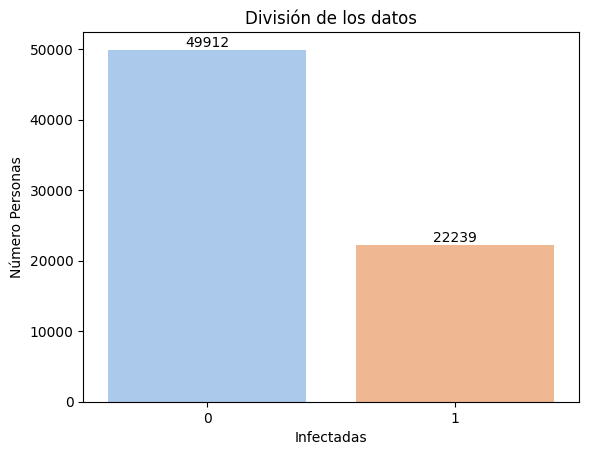

In [10]:
ax = sns.countplot(x=target_var, data=aids_df, palette='pastel')
plt.title('División de los datos')
plt.xlabel('Infectadas')
plt.ylabel('Número Personas')
# Añadir anotaciones
for container in ax.containers:
    ax.bar_label(container, label_type='edge')
plt.show()

### Analisis univariante de los datos

#### Analisis de cada una de las variables que conforman el dataset
Este analisis se lo realiza para conocer como esta la distribución de los datos y conocer la calidad de los mismos

In [11]:
def analysis_numeric_colum(df,col,ylabel=None,xlabel=None,title_hist=None,title_bar=None):
    sns.set(font_scale=0.8)
    sns.set_style("white")
    #Crear un histograma para las variables numericas
    sns.histplot(df[col], bins=60)
    if (ylabel is not None):
        plt.ylabel(ylabel)
    if (xlabel is not None):
        plt.xlabel(xlabel)
    plt.title("Histograma de la variable {var}".format(var=col), fontsize=14)
    plt.tight_layout()        
    plt.show()
    
    #Para graficar el box plot
    sns.set(style="whitegrid")
    sns.boxplot(x=df[col])
    plt.title('Diagrama de caja de la variable {var}'.format(var=col))
        
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.tight_layout()        
    plt.show()
    print("Valor de skewness:{skewness}".format(skewness=df[col].skew()))
    print("***Datos resumidos de la variable***")
    print(df[col].describe())
    
def analysis_categorical_colum(df,col,ylabel='Frecuencia',xlabel='Categoria'):
    value_cont = df[col].value_counts()
    bars = plt.bar(value_cont.index.astype(str), value_cont, color='skyblue')

    # Añadir etiquetas a las barras
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2, yval + 1, round(yval, 2), ha='center', va='bottom')
 
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    if (ylabel is not None):
        plt.ylabel(ylabel)
    if (xlabel is not None):
        plt.xlabel(xlabel)
    plt.title('Grafico de barra de la variable {var}'.format(var=col))
    if col=='karnof':
        plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()
    


#### Analizando la variable time

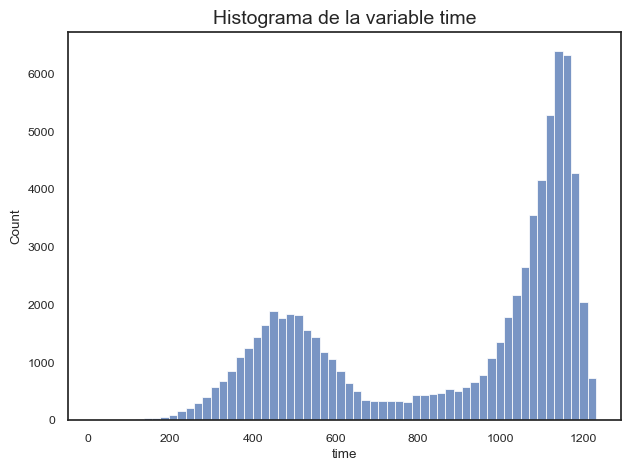

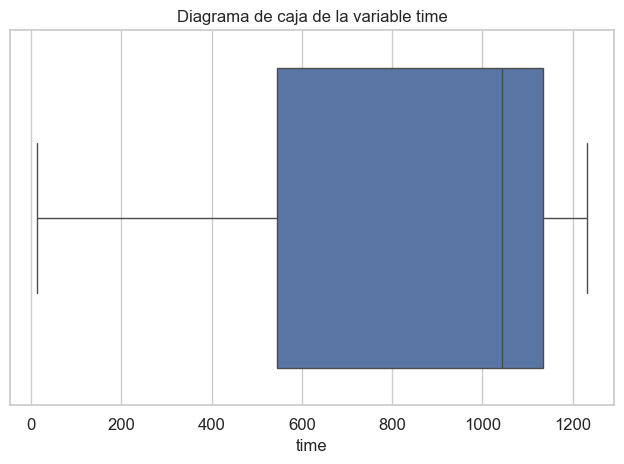

Valor de skewness:-0.622045882853219
***Datos resumidos de la variable***
count    72149.000000
mean       877.552745
std        306.787659
min         14.000000
25%        545.000000
50%       1043.000000
75%       1135.000000
max       1231.000000
Name: time, dtype: float64


In [12]:
analysis_numeric_colum(df=aids_df,col='time')

##### Resumen de la encontrado en la variable time
**Distribución**: Se observa que la variable time no presenta una distribución normal, ni de cauchy, ni exponencial en sus datos.\
**Valor de skewness**: Un valor negativo nos indica que la cola izquierda de la distribución tiene valores más bajos que la cola derecha debido y los datos estan concentrados en los valores más altos. \
**Outliers**: Revisando el diagrama de caja se puede observar que no existen outliers que sobrepasen la media de los datos pero existen pequeños outliers que estan distribuidos esto sucede debido a que al no seguir una distribución normal por lo que se debe de analizar el impacto de estos datos atipicos.

#### Analizando la variable age

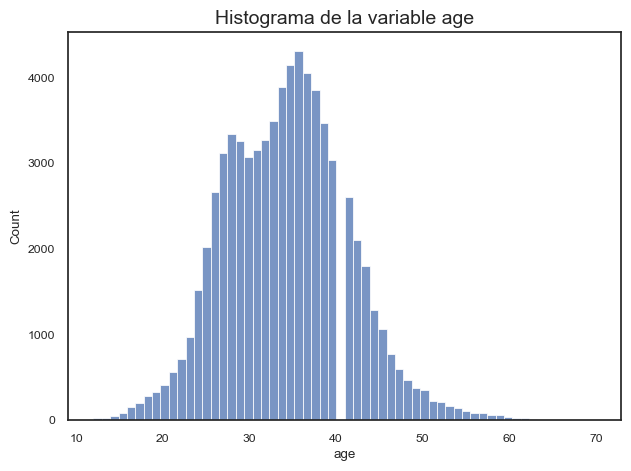

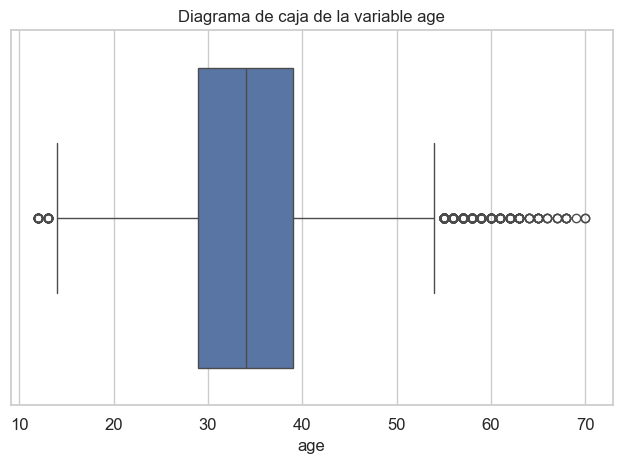

Valor de skewness:0.24249364517199046
***Datos resumidos de la variable***
count    72151.000000
mean        34.224293
std          7.136543
min         12.000000
25%         29.000000
50%         34.000000
75%         39.000000
max         70.000000
Name: age, dtype: float64


In [13]:
analysis_numeric_colum(df=aids_df,col='age')

##### Resumen de la encontrado en la variable age
**Distribución**: Se observa que la variable age tiene una distribución normal en sus datos.\
**Valor de skewness**: Un valor cercano nos indica que tiene una distribución simetrica don de la mayoria de sus datos estan centraso en la izquierda del grafico. \
**Outliers**: La media y la mediana son aproximadamente iguales, por lo tanto, podemos concluir que los valores atípicos no están afectando los datos.

#### Analizando la variable wtkg

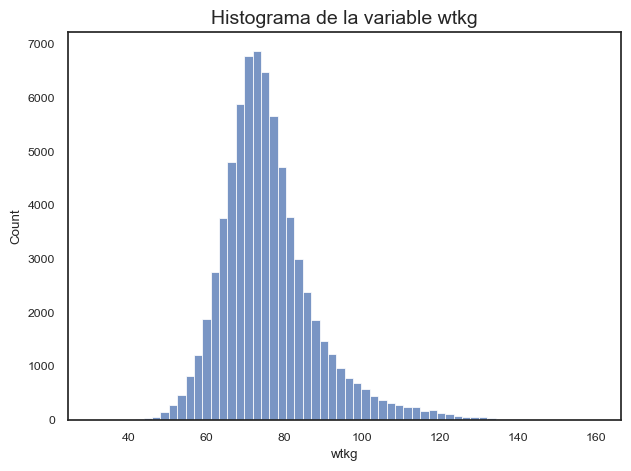

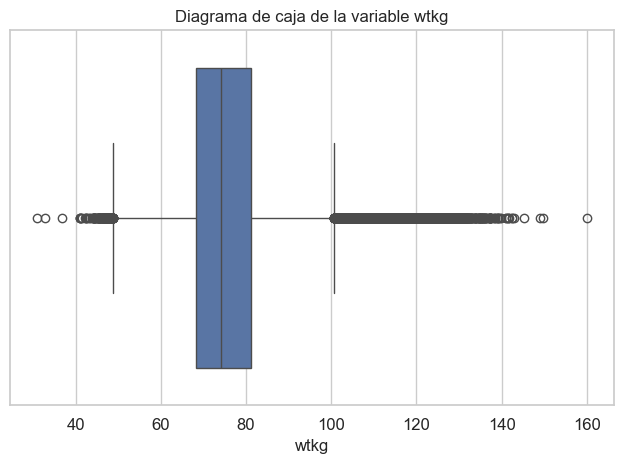

Valor de skewness:1.1805641928554271
***Datos resumidos de la variable***
count    72144.000000
mean        75.878760
std         12.127116
min         31.000000
25%         68.213390
50%         74.065575
75%         81.216113
max        159.939360
Name: wtkg, dtype: float64


In [14]:
analysis_numeric_colum(df=aids_df,col='wtkg',title_hist='Histograma de la varaible wtkg', title_bar='Diagrama de caja de la variable wtkg')

##### Resumen de la encontrado en la variable wtkg
**Distribución**: Se observa que la variable age tiene una distribución normal en sus datos.\
**Valor de skewness**: Un valor positivo nos indica que la mayoria de los datos estan concentrados en el lado izquierdo del grafico. \
**Outliers**: La media y la mediana son aproximadamente iguales, por lo tanto, podemos concluir que los valores atípicos no están afectando a la media, pero existe una gran cantidad de valors atípicos están presentes más allá de 100.

#### Analizando la variable preanti

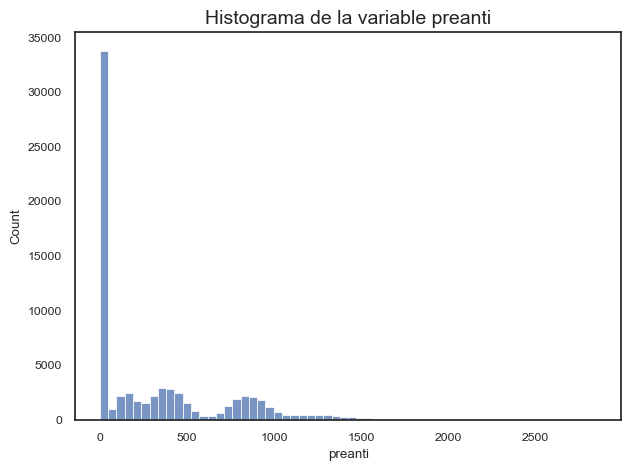

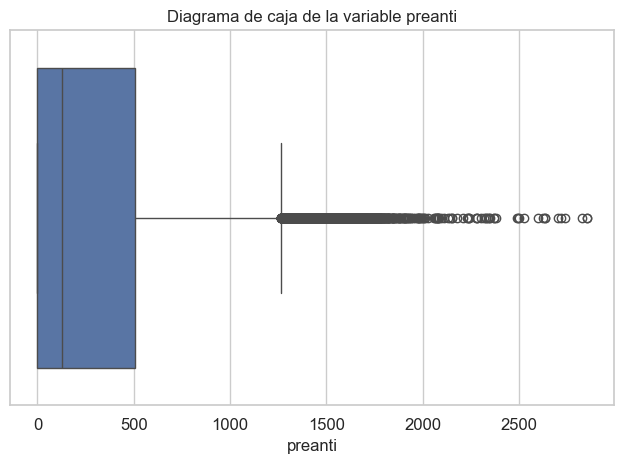

Valor de skewness:1.2431877061154826
***Datos resumidos de la variable***
count    72148.000000
mean       319.505530
std        404.529118
min          0.000000
25%          0.000000
50%        125.000000
75%        506.000000
max       2851.000000
Name: preanti, dtype: float64


In [15]:
analysis_numeric_colum(df=aids_df,col='preanti')

##### Resumen de la encontrado en la variable preanti
**Acerca de la variable**: Preanti significa el número de días o la duración (en días, semanas u otra unidad de tiempo) que un paciente ha estado en terapia antirretroviral antes de alcanzar la marca de 175 semanas desde el inicio de la observación o tratamiento. \
**Distribución**: no presenta una distribución normal, ni de cauchy, ni exponencial en sus datos .\
**Valor de skewness**: Un valor positivo nos indica que la mayoria de los datos estan concentrados en el lado izquierdo del gráfico. \
**Outliers**: La media es alta comparada con la mediana, hay valores atipicos presentes. `La desviación estándar es alta, una desviación estándar de 400 días indica que las duraciones de la terapia entre los pacientes varían ampliamente alrededor de la media`. Esto significa que algunos pacientes pueden haber tenido duraciones muy cortas de terapia, mientras que otros tuvieron duraciones muy largas, en relación con el promedio.

#### Analizando la variable cd40

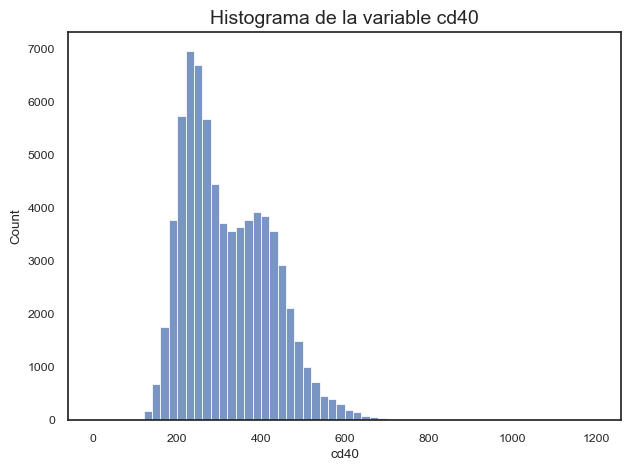

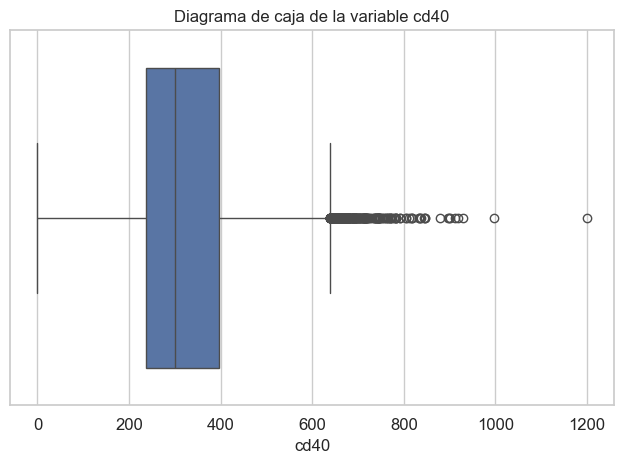

Valor de skewness:0.6454567629785538
***Datos resumidos de la variable***
count    72150.000000
mean       319.989508
std        103.186223
min          0.000000
25%        236.000000
50%        300.000000
75%        397.000000
max       1199.000000
Name: cd40, dtype: float64


In [16]:
analysis_numeric_colum(df=aids_df,col='cd40')

##### Resumen de la encontrado en la variable cd40
**Acerca de la variable**: Las células CD4, también conocidas como células T CD4+, son un tipo de glóbulo blanco que desempeña un papel crucial en el sistema inmunitario. Ayudan a coordinar la respuesta inmunitaria al señalar a otras células del sistema inmunitario para que realicen sus funciones.\
Las personas que viven con VIH y tienen un recuento de CD4 superior a 500 generalmente gozan de buena salud. Aquellas que tienen un recuento de células CD4 por debajo de 200 tienen un alto riesgo de desarrollar enfermedades graves. Se recomienda el tratamiento contra el VIH para todas las personas que viven con esta condición, siendo especialmente importante para aquellos con recuentos bajos de CD4.\
**Observación**: `La mayoría de los pacientes tienen un recuento cercano a 300, lo cual es un poco preocupante`.\
**Distribución**: No presenta una distribución normal, ni de cauchy, ni exponencial en sus datos.\
**Valor de skewness**: Un valor ligeramente positivo indica que que se tiene una distribución asimetrica, donde la mayoria de los valores están concentrados en la lado izquierdo del gráfico. \
**Outliers**: Se tiene una desviación estandar de 103 lo cual es alto, por lo cual supondria la existencia de valores atípicos.

#### Analizando la variable cd80

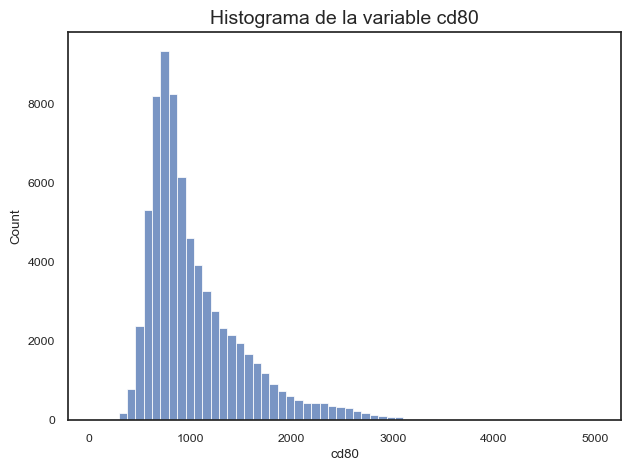

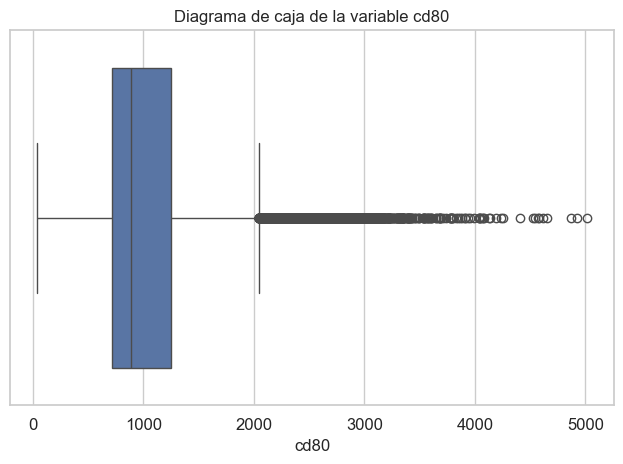

Valor de skewness:1.6525963215401884
***Datos resumidos de la variable***
count    72150.000000
mean      1045.157089
std        488.915021
min         40.000000
25%        713.000000
50%        887.000000
75%       1245.000000
max       5011.000000
Name: cd80, dtype: float64


In [17]:
analysis_numeric_colum(df=aids_df,col='cd80')

##### Resumen de la encontrado en la variable cd80
**Acerca de la variable**: Las células CD8, son un tipo de glóbulo blanco que desempeña un papel crucial en el sistema inmunológico al eliminar directamente las células infectadas, incluidas aquellas infectadas con virus como el VIH. Normalmente, la infección por VIH conduce a un aumento en las células T CD8+ a medida que el sistema inmunológico intenta combatir el virus. \
**Observación**: `La relación CD4/CD8 es una métrica importante en el VIH/SIDA. Normalmente, la relación es mayor que 1, lo que significa que hay más células CD4 que células CD8. En la infección por VIH, esta relación a menudo disminuye debido al declive en las células CD4 y al aumento en las células CD8`.\
**Distribución**: Presenta la forma de una distribución normal en sus datos. \
**Valor de skewness**: Un valor ligeramente positivo indica que que se tiene una distribución asimetrica, donde la mayoria de los valores están concentrados en la lado izquierdo del gráfico. \
**Outliers**: Se tiene una desviación estandar de 488 lo cual es alto, por lo cual supondria la existencia de valores atípicos.

#### Analizando la variable cd820

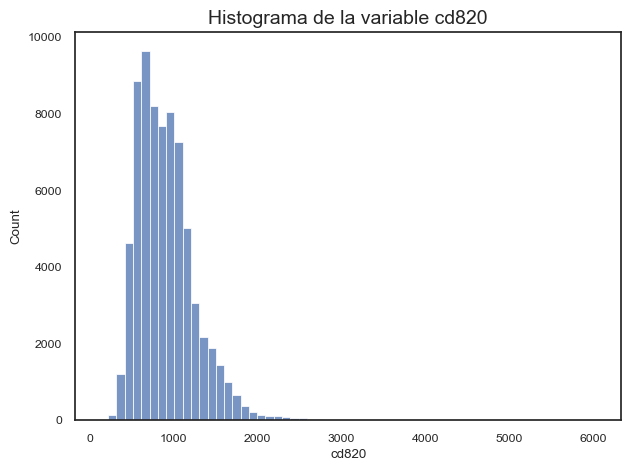

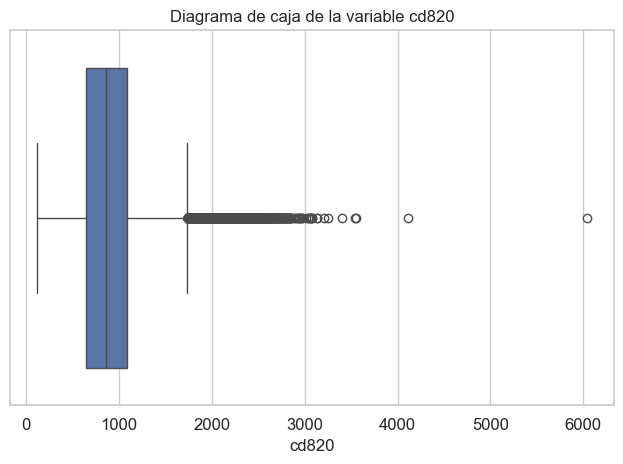

Valor de skewness:1.2455984418931496
***Datos resumidos de la variable***
count    72149.000000
mean       907.329263
std        342.960983
min        124.000000
25%        649.000000
50%        858.000000
75%       1085.000000
max       6035.000000
Name: cd820, dtype: float64


In [18]:
analysis_numeric_colum(df=aids_df,col='cd820')

##### Resumen de la encontrado en la variable cd820
**Acerca de la variable**:La variable 'cd820' representa el recuento de CD8 medido aproximadamente a las 20 semanas (con un margen de +/- 5 semanas) después de una medición inicial o de referencia. \
**Observación**: `Los cambios en el recuento de CD8 desde el inicio hasta alrededor de las 20 semanas pueden indicar la efectividad del tratamiento. Un aumento o un recuento estable de CD8 podría sugerir que el sistema inmunológico está respondiendo bien al tratamiento, mientras que una disminución podría indicar posibles problemas con la efectividad del tratamiento`.\
**Distribución**: Presenta la forma de una distribución normal en sus datos. \
**Valor de skewness**: Un valor ligeramente positivo indica que que se tiene una distribución asimetrica, donde la mayoria de los valores están concentrados en la lado izquierdo del gráfico. \
**Outliers**: Se tiene una desviación estandar de 342 lo cual es alto, por lo cual supondria la existencia de valores atípicos.

#### Analizando la variable drugs

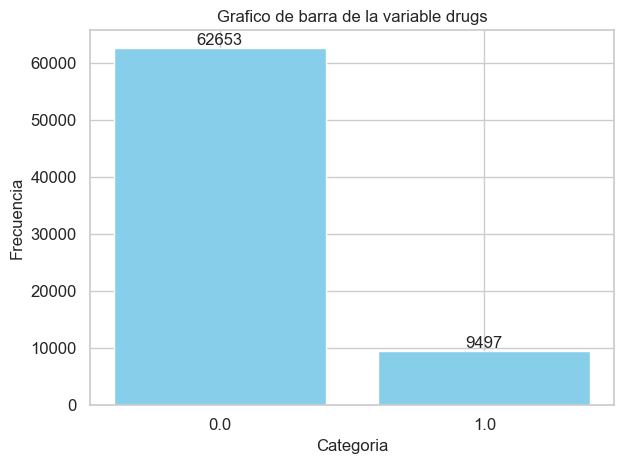

In [19]:
analysis_categorical_colum(df=aids_df,col='drugs')

##### Resumen de la encontrado en la variable drugs
**Acerca de la variable**:Historia de uso de drogas. \
**Observación**: `La mayoría de los pacientes no tienen antecedentes de consumo de drogas`.\
**Distribución**: Presenta la forma de una distribución de Bernoulli en sus datos.

#### Analizando la variable strat

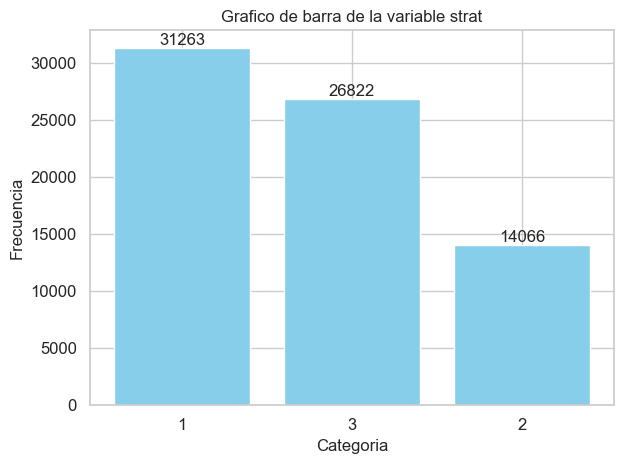

In [20]:
analysis_categorical_colum(df=aids_df,col='strat')

##### Resumen de la encontrado en la variable strat
**Observación**: `La mayoría de los pacientes no tienen antecedentes con los retrovirales`.\
**Distribución**: No presenta la forma de una distribución de Bernoulli, ni de Poison en sus datos. 

#### Analizando la variable karnof

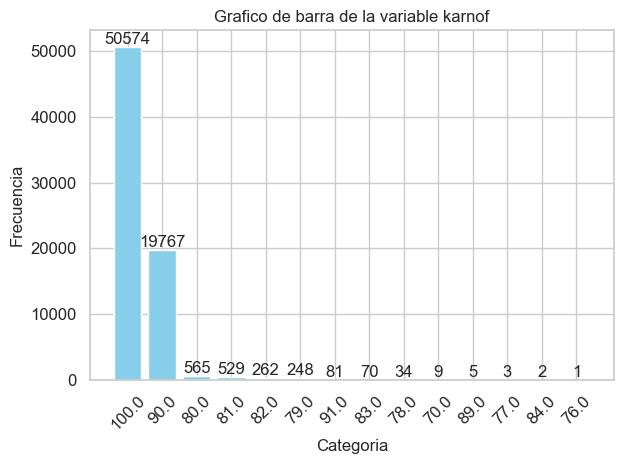

In [21]:
analysis_categorical_colum(df=aids_df,col='karnof')

##### Resumen de la encontrado en la variable karnof
**Acerca de la variable**: El Estado Funcional de Karnofsky  es una medida ampliamente utilizada del estado funcional y bienestar general en pacientes con diversas condiciones médicas, incluyendo el SIDA. En el contexto del SIDA, la puntuación de Karnofsky es especialmente relevante para evaluar el impacto de la enfermedad en el estado funcional del paciente y determinar intervenciones adecuadas de tratamiento y cuidado de apoyo. La puntuación se evalúa típicamente a través de una breve evaluación clínica y se basa en la capacidad del paciente para realizar actividades como el autocuidado, la deambulación y el trabajo. \
**Observación**: `La puntuación de Karnofsky varía de 0 a 100, siendo las puntuaciones más altas indicativas de un mejor estado funcional y bienestar general`.\
**Distribución**: No presenta la forma de una distribución de Bernoulli, ni de Poison en sus datos.

#### Analizando la variable oprior

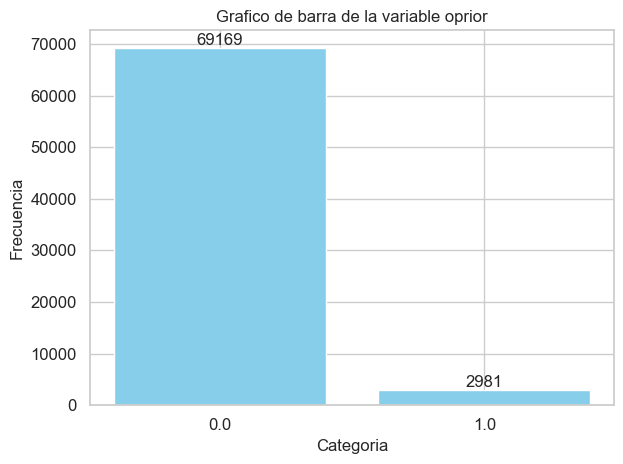

In [22]:
analysis_categorical_colum(df=aids_df,col='oprior')


##### Resumen de la encontrado en la variable oprior
**Acerca de la variable**: La terapia antirretroviral es un componente crítico en el manejo de la infección por VIH, y las terapias no ZDV se refieren a medicamentos antirretrovirales distintos de Zidovudina. Monitorear la administración de tales terapias en el contexto de conjuntos de datos de infección por SIDA ayuda a los investigadores a comprender el impacto de diferentes esquemas de tratamiento en la progresión de la enfermedad, los resultados del paciente y las estrategias generales de manejo de la salud. \
Representa si se administró terapia antirretroviral no ZDV (Zidovudina) antes de las 175 semanas (aproximadamente 3.3 años) de observación. \
**Observación**: `La mayoría de los pacientes no fueron aplicados la terapia antiretroviral`.\
**Distribución**: Presenta la forma de una distribución de Bernoulli en sus datos.

#### Analizando la variable symptom

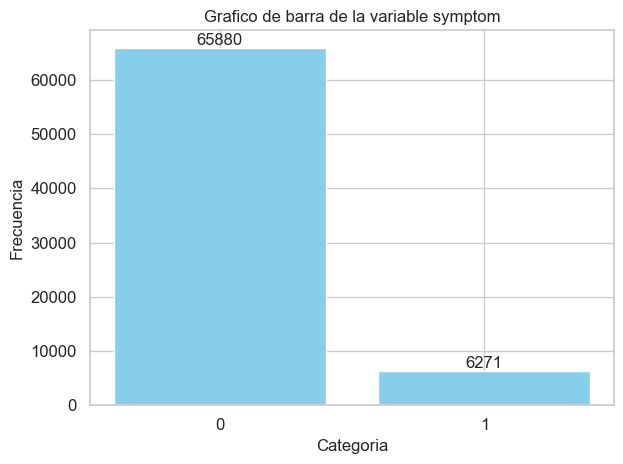

In [23]:
analysis_categorical_colum(df=aids_df,col='symptom')

##### Resumen de la encontrado en la variable symptom
**Acerca de la variable**: Indicador de sintomas. \
**0**: Individuos categorizados como "asymp" (asintomáticos) no presentan síntomas evidentes asociados con el VIH/SIDA en el momento de la evaluación. Pueden ser portadores del virus pero aún no han desarrollado síntomas o manifestaciones clínicas de la enfermedad. Los individuos asintomáticos aún pueden ser infecciosos y capaces de transmitir el virus a otras personas. \
**1**: Individuos categorizados como "symp" (sintomáticos) muestran síntomas o manifestaciones clínicas del VIH/SIDA en el momento de la evaluación. Estos síntomas pueden incluir, entre otros, fiebre, fatiga, pérdida de peso, sudores nocturnos, ganglios linfáticos inflamados, infecciones oportunistas y otras enfermedades definitorias del SIDA. Los individuos sintomáticos típicamente requieren evaluación médica, tratamiento y manejo de complicaciones relacionadas con el VIH/SIDA. \
**Observación**: `La mayoría de los pacientes no tienen ningun sintoma`.\
**Distribución**: Presenta la forma de una distribución de Bernoulli en sus datos. \

#### Analizando la variable offtrt

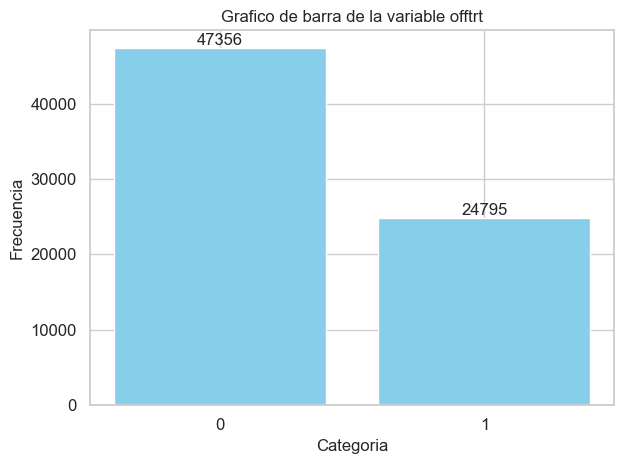

In [24]:
analysis_categorical_colum(df=aids_df,col='offtrt')

##### Resumen de la encontrado en la variable offtrt
**Acerca de la variable**: La variable 'offtrt' representa un indicador de haber interrumpido el tratamiento antes de un marco de tiempo específico, típicamente 96 semanas (aproximadamente 2 años) con un margen de 5 semanas. \
**0**: Esto significa que o bien permanecieron en tratamiento de manera continua durante este período o no tuvieron interrupciones en su régimen de tratamiento que excedieran el umbral definido. \
**1**: Esto indica que en algún momento durante el período previo a las 96 semanas, experimentaron una interrupción o cesación en su régimen de tratamiento, ya sea de manera intencional o no intencional, que duró más allá del umbral definido.\
**Observación**: `La mayoría de los pacientes han mantenido exitosamente su terapia antirretroviral sin interrupciones significativas durante el período especificado`.\
**Distribución**: Presenta la forma de una distribución de Bernoulli en sus datos.

#### Analizando la variable race

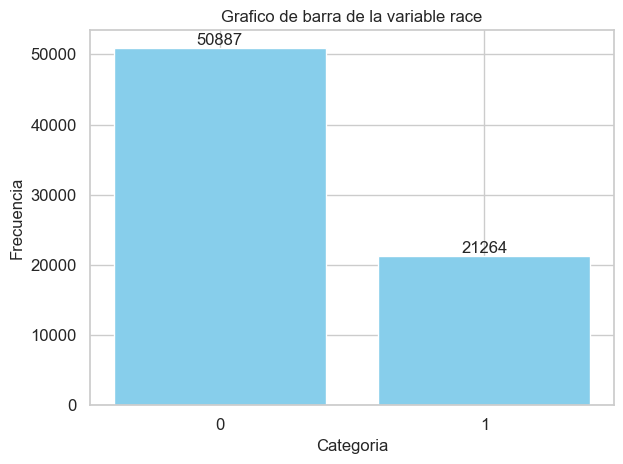

In [25]:
analysis_categorical_colum(df=aids_df,col='race')

##### Resumen de la encontrado en la variable race
**Acerca de la variable**: La raza del paciente. \
**Observación**: `La mayoría de los pacientes son blancos`.\
**Distribución**: Presenta la forma de una distribución de Bernoulli en sus datos. 

#### Analizando la variable gender

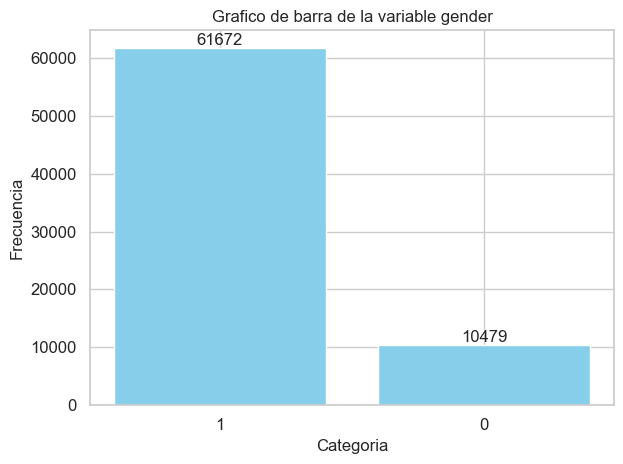

In [26]:
analysis_categorical_colum(df=aids_df,col='gender')

##### Resumen de la encontrado en la variable gender
**Acerca de la variable**: El genero de la persona 0=F, 1=M. \
**Observación**: `La mayoría de los pacientes son hombres`.\
**Distribución**: Presenta la una distribución de Bernoulli en sus datos.

#### Analizando la variable str2

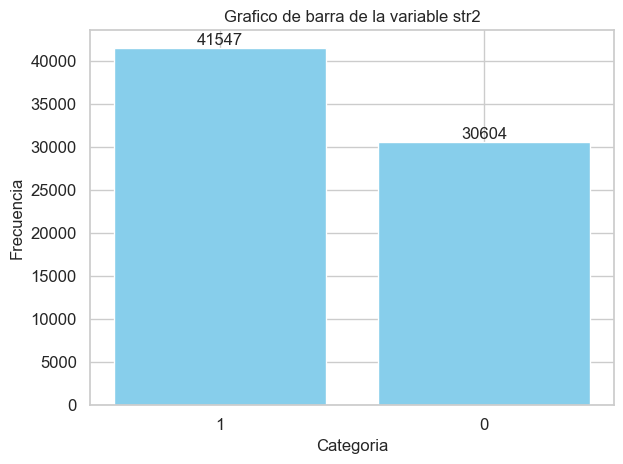

In [27]:
analysis_categorical_colum(df=aids_df,col='str2')

##### Resumen de la encontrado en la variable str2
**Acerca de la variable**: La variable str2 representa el historial antirretroviral de los individuos, específicamente si no han recibido tratamiento o experimentados con la terapia antirretroviral. \
**Observación**: `La mayoría de los pacientes tenían experiencia y habían sido tratados previamente con medicamentos antirretrovirales`.\
**Distribución**: Presenta la forma de una distribución de Bernoulli en sus datos.

#### Analizando la variable homo

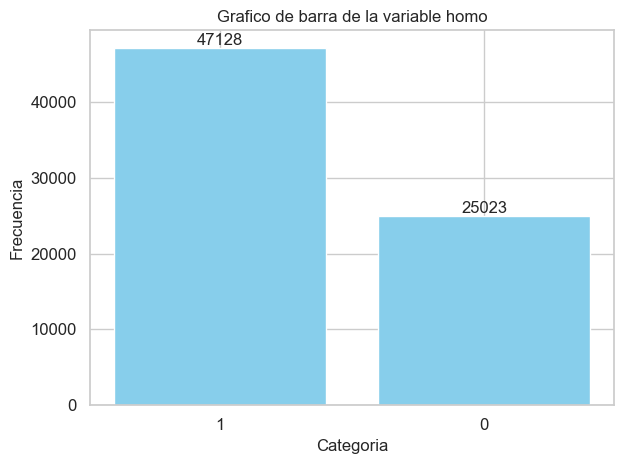

In [28]:
analysis_categorical_colum(df=aids_df,col='homo')

##### Resumen de la encontrado en la variable homo
**Acerca de la variable**: La actividad homosexual se refiere a la actividad sexual entre individuos del mismo sexo, a menudo entre hombres. Históricamente, la actividad homosexual se ha asociado con un mayor riesgo de transmisión del VIH debido a varios factores. \
**Observación**: `La mayoría de los pacientes ha participado en actividades homosexuales`.\
**Distribución**: Presenta la forma de una distribución de Bernoulli en sus datos. 

#### Analizando la variable treat

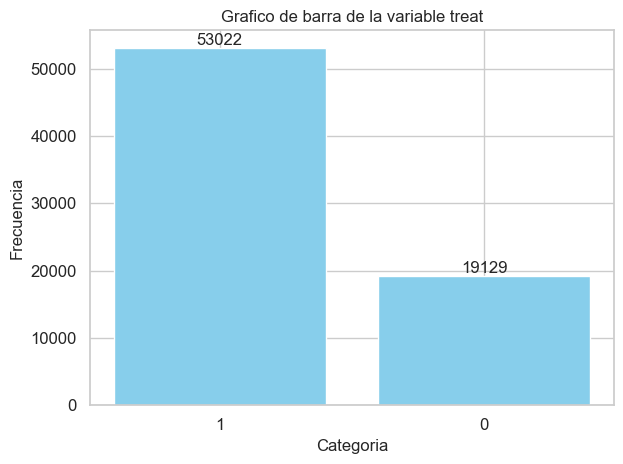

In [29]:
analysis_categorical_colum(df=aids_df,col='treat')

##### Resumen de la encontrado en la variable treat
**Acerca de la variable**: Indicador del tratamiento 0 ZDV 1 otros. \
**Observación**: `Los pacientes optaron por tratamientos diferentes a solo ZDV`.\
**Distribución**: Presenta la forma de una distribución de Bernoulli en sus datos.

#### Analizando la variable z30

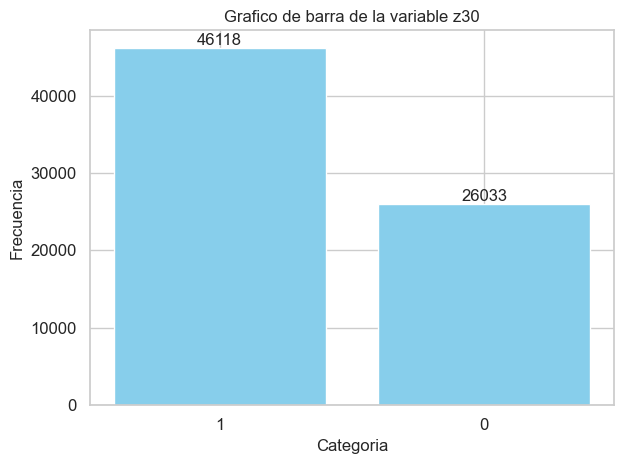

In [30]:
analysis_categorical_colum(df=aids_df,col='z30')

##### Resumen de la encontrado en la variable z30
**Acerca de la variable**: Se refiere a si la Zidovudina (ZDV), un medicamento antirretroviral, fue administrada en los 30 días previos a la marca de 175 semanas de observación.
La Zidovudina, también conocida como AZT, fue uno de los primeros medicamentos utilizados para tratar el VIH y sigue siendo un componente importante de la terapia antirretroviral. Al examinar la variable "z30", los investigadores pueden evaluar el uso a corto plazo de ZDV en las semanas previas a la marca de 175 semanas y su posible impacto en los resultados del paciente. \
**Observación**: `No hay una alta correlación evidente, la mayoría de los pacientes recibieron el medicamento`.\
**Distribución**: Presenta la forma de una distribución de Bernoulli en sus datos.

#### Analizando la variable hemo

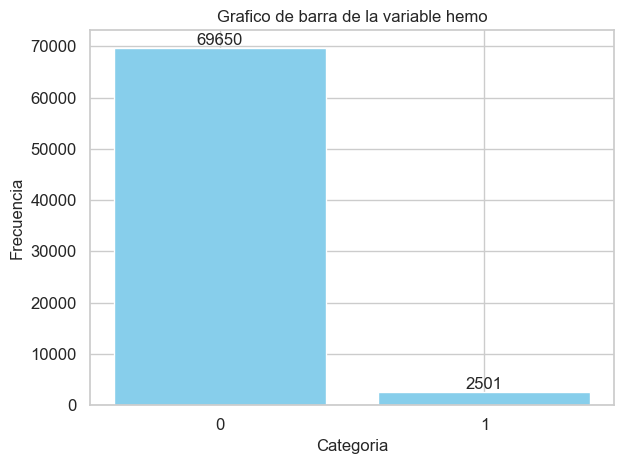

In [31]:
analysis_categorical_colum(df=aids_df,col='hemo')

##### Resumen de la encontrado en la variable hemo
**Acerca de la variable**: Se refiere a un trastorno genético caracterizado por la incapacidad de la sangre para coagularse normalmente. Las personas con hemofilia carecen de ciertas proteínas, conocidas como factores de coagulación, que son esenciales para la coagulación de la sangre. Como resultado, tienen un mayor riesgo de sangrado excesivo, tanto interno como externo, incluso por lesiones menores. \
**Observación**: `La mayoría de los pacientes no tienen hemofilia`.\
**Distribución**: Presenta la forma de una distribución de Bernoulli en sus datos. \

#### Analizando la variable trt

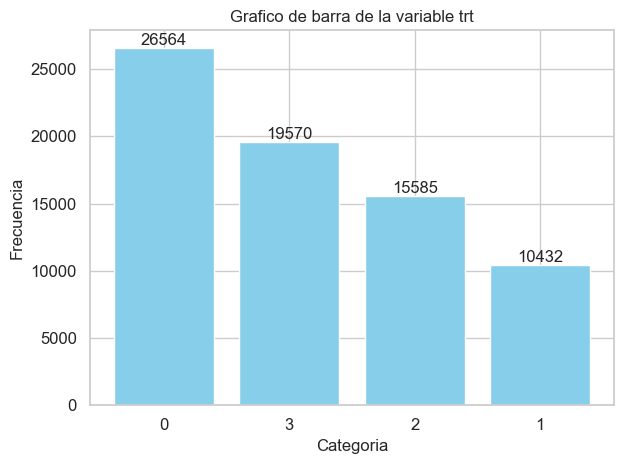

In [32]:
analysis_categorical_colum(df=aids_df,col='trt')

##### Resumen de la encontrado en la variable trt
**Acerca de la variable**: El indicador de tratamiento proporciona información sobre el tipo de régimen de tratamiento antirretroviral que están recibiendo los pacientes en el conjunto de datos. \
**0**: Solo ZDV \
**1**: ZDV + ddI, la terapia combinada a menudo se usa para mejorar la eficacia del tratamiento mediante el uso de medicamentos con diferentes mecanismos de acción. \
**2** : ZDV + Zal, la combinación de ZDV y Zal es otra estrategia para mejorar la efectividad del tratamiento y retrasar la progresión de la enfermedad. \
**3** : Solo ddI, esto puede ser un régimen alternativo para pacientes que no pueden tolerar ZDV o para quienes ZDV no es efectivo. \
**Observación**: `La mayoría de los pacientes están recibiendo solo ZDV o solo ddI`.\
**Distribución**: No presenta la forma de una distribución de Bernoulli, ni de Poison en sus datos. 

### Analisis bivariante

In [33]:
def bivariante_graphs_categorial(df, target):
    sns.set(font_scale=1)
    col_analysis = df.columns.to_list()
    col_analysis.remove(target_var)
    num_subplots = len(col_analysis)
    fig, axes = plt.subplots(num_subplots, 1, figsize=(10, 6 * num_subplots))
    for i, col in enumerate(col_analysis):
        sns.countplot(data=df, x=col, ax=axes[i], hue=target, order=df[col].value_counts().index)
        ax = axes[i]
        for p in ax.patches:
            ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center', fontsize=11, color='black', xytext=(0, 5),
                    textcoords='offset points')

        ax.set_title(f'Gráfico de Barras Apiladas para {col}')
        ax.set_xlabel(col)
        ax.set_ylabel('Conteo')
        
        

    plt.tight_layout()
    plt.show()
    
def bivariante_graphs_numerical(df,target):
    
    is_first_column = False
    fist_col = None
    col_analysis = df.columns.to_list()
    col_analysis = col_analysis.remove(target)
    for col in df.columns:
        if is_first_column == False:
            is_first_column=True
            fist_col = col
        else:
            plt.figure(figsize=(10, 6))
            sns.scatterplot(data=df, x=fist_col, y=col, hue=target)
            plt.title(f'Gráfico de dispersión entre {fist_col} y {col}')
            plt.xlabel(fist_col)
            plt.ylabel(col)
            plt.show()
    

#### Graficos de las variables categoricas
Se realiza los graficos de las varibles discretas con respecto a su clasificación de la variable objetivo

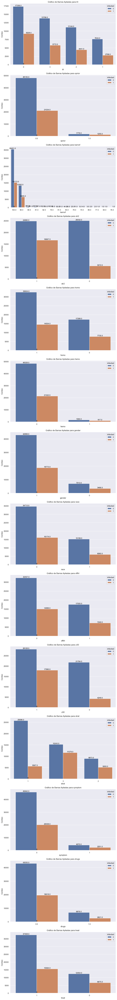

In [34]:
bivariante_graphs_categorial(aids_df[dis_cols+[target_var]], target_var)

#### Graficos de las variables numericas
En el caso de las variables numericas lo que mejor ayuda a comprender como estan relacionadas las variables son los diagramas de dispersión

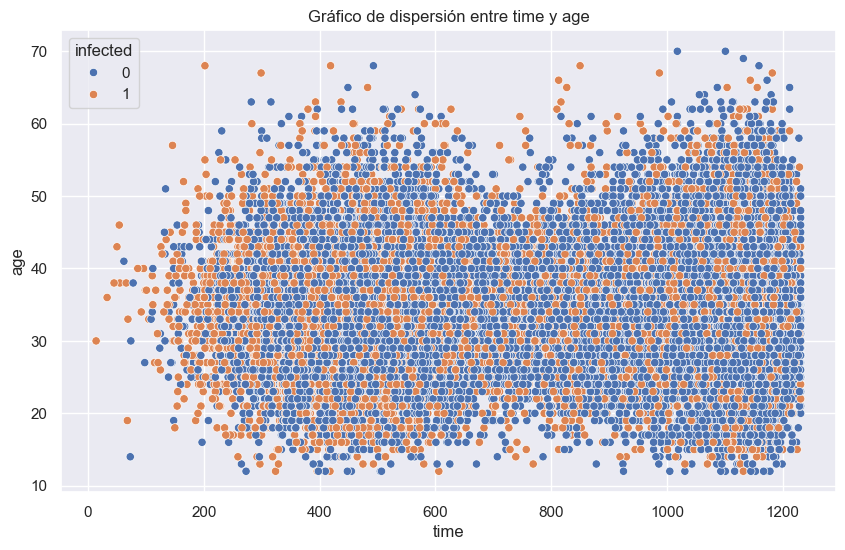

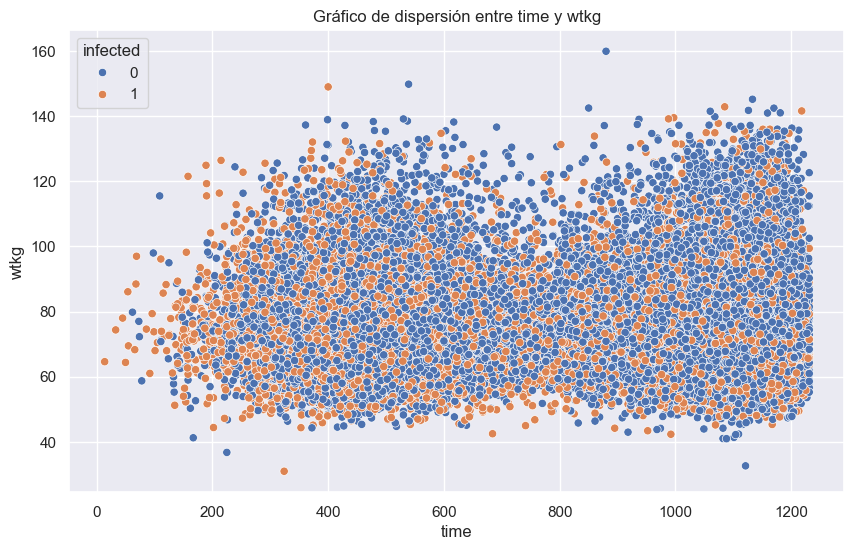

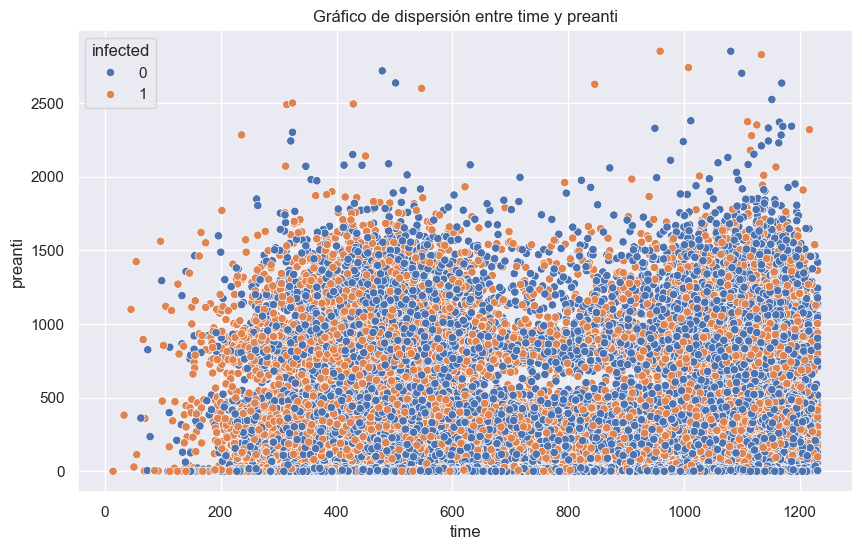

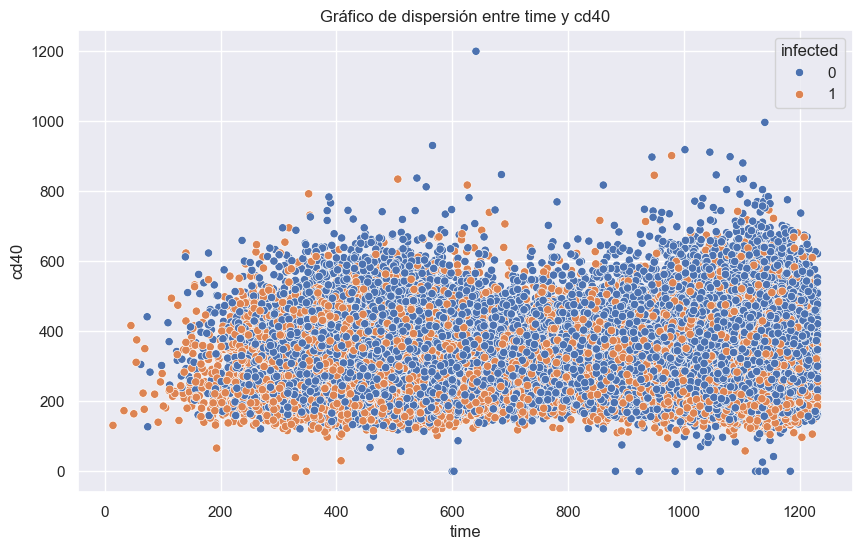

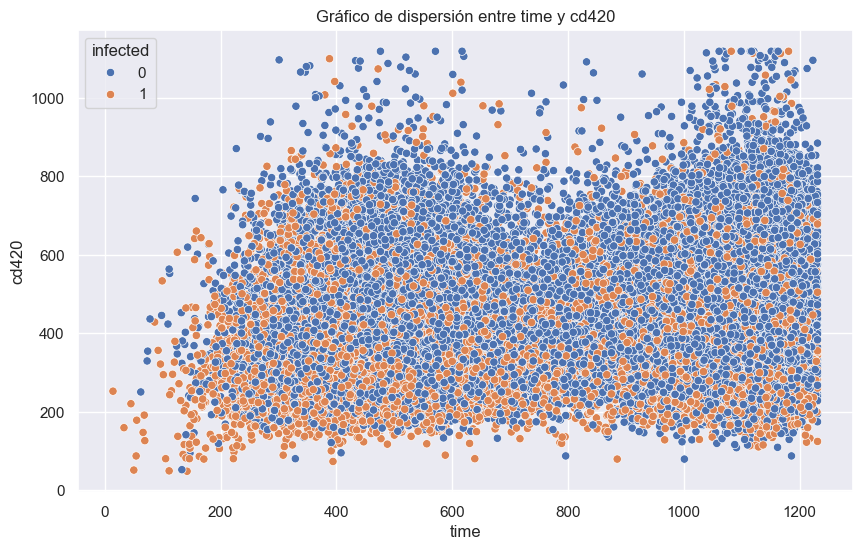

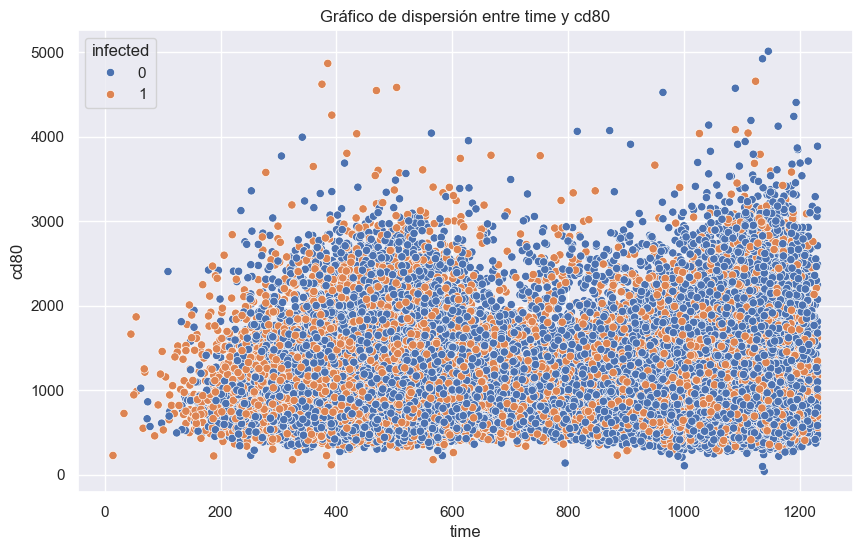

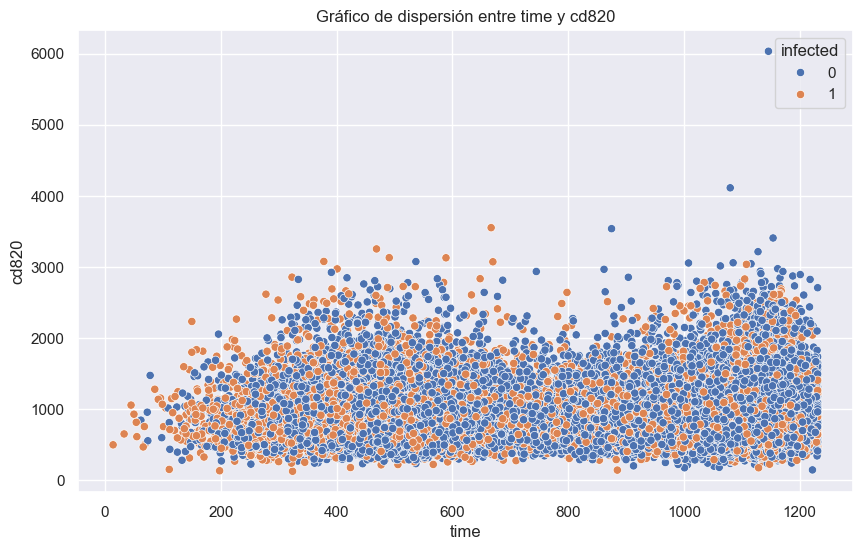

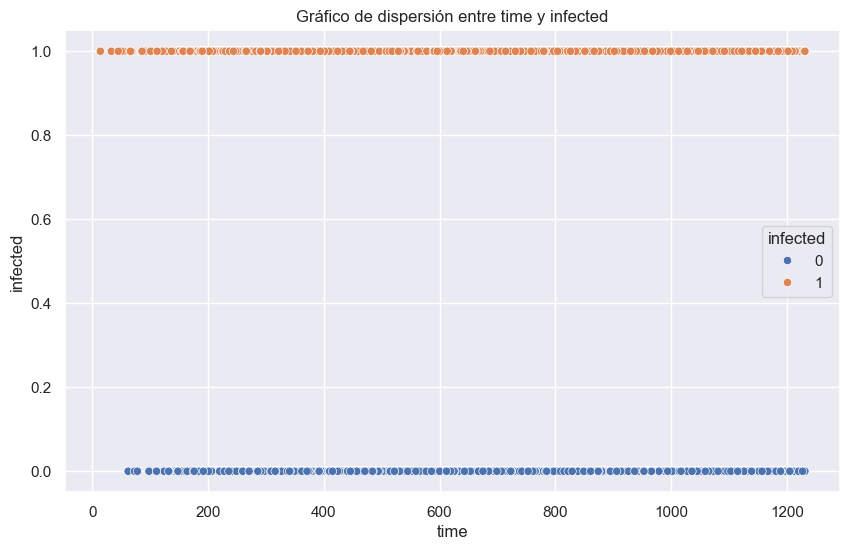

In [35]:
bivariante_graphs_numerical(aids_df[cont_cols+[target_var]],target_var)

# Fase 3: Preparación de Datos

## Limpieza de Datos
Llevar a cabo la limpieza de datos para manejar valores faltantes, outliers y datos inconsistentes utilizando técnicas avanzadas como imputación basada en modelos y detección de anomalías.


### Eliminar los datos duplicados del dataframe encontrados en la anterior etapa de analisis

In [36]:
aids_df.drop_duplicates(inplace= True,ignore_index=True)
aids_duplicated = aids_df[aids_df.duplicated()]
aids_duplicated

,time,trt,age,wtkg,hemo,homo,drugs,karnof,oprior,z30,preanti,race,gender,str2,strat,symptom,treat,offtrt,cd40,cd420,cd80,cd820,infected


**El dataframe ya no contiene valores duplicados y los indices fueron restablecidos, depués de borrar los duplicados**

### Analisis de los datos que tienen valores nulos
Se va a identificar los registros que tienen almenos un valor nulo en todas las columnas del dataframe

In [37]:
registros_con_nulos = aids_df[aids_df.isnull().any(axis=1)]
print('Existen {num_nulos} registros con algun valor nulo en el dataframe'.format(num_nulos=len(registros_con_nulos)))

Existen 22 registros con algun valor nulo en el dataframe


In [38]:
#Se reinicia los indices para ver de mejor manera los registros que tienen algun valor nulo
registros_con_nulos.reset_index()

,index,time,trt,age,wtkg,hemo,homo,drugs,karnof,oprior,z30,preanti,race,gender,str2,strat,symptom,treat,offtrt,cd40,cd420,cd80,cd820,infected
0,70,1073.0,0,41,NaN,0,0,1.0,90.0,0.0,1,784.0,0,1,1,3,0,0,1,210.0,210.0,810.0,710.0,0
1,91,1138.0,2,37,69.00000,0,1,1.0,90.0,0.0,1,619.0,0,1,1,3,0,1,0,360.0,NaN,710.0,840.0,0
2,118,1112.0,0,40,55.33920,0,0,0.0,100.0,0.0,1,NaN,1,0,1,3,0,0,0,338.0,312.0,1664.0,1191.0,0
3,161,643.0,0,23,NaN,0,1,0.0,90.0,0.0,1,431.0,0,1,1,3,0,0,0,265.0,549.0,680.0,784.0,1
4,206,1028.0,0,40,89.81280,0,1,0.0,100.0,0.0,0,0.0,0,1,0,1,0,0,0,329.0,600.0,NaN,1488.0,0
5,242,1104.0,0,38,79.38000,0,1,0.0,90.0,0.0,1,NaN,0,1,1,3,0,0,0,369.0,400.0,612.0,816.0,0
6,288,966.0,2,25,NaN,0,0,0.0,100.0,0.0,1,290.0,1,0,1,2,0,1,1,337.0,355.0,784.0,770.0,0
7,338,NaN,1,39,80.80000,0,1,0.0,100.0,0.0,1,1582.0,0,1,1,3,0,1,0,384.0,339.0,1215.0,927.0,0
8,377,1059.0,2,20,47.40120,0,1,0.0,90.0,0.0,0,0.0,1,0,0,1,0,1,0,292.0,NaN,909.0,1010.0,0
9,422,1145.0,3,34,NaN,0,0,0.0,100.0,0.0,1,372.0,0,1,1,3,1,1,0,296.0,338.0,850.0,756.0,0


In [39]:
#Se elimina los registros que tienen almenos un valor nulo
aids_df.dropna(inplace=True)

In [40]:
#Se vuelve a verificar los valores nulos en el dataframe
registros_con_nulos = aids_df[aids_df.isnull().any(axis=1)]
print('Existen {num_nulos} registros con algun valor nulo en el dataframe'.format(num_nulos=len(registros_con_nulos)))

Existen 0 registros con algun valor nulo en el dataframe


**Dado que se tenian 22 registros de un total de 72151 registros que tienen el dataframe, se elimino dichos registros ya que no representan una  cantidad significativa en los datos**

### Detección de outliers

#### Detección de outliers en variables categoricas
Para detectar los valores atipicos en las variables categoricas no es tan directo como en las variables continuas ya que no podemos basarnos en un valor que representa una cantidad como puede ser el peso de una persona, por lo cual para realizar un analisi en base a la frecuencia de los valores cuando se tenga mas de dos valores ya que es alli donde se puede encontrar una categorias menos representativas. \
- Las variables `drugs, oprior, symptom, offtrt, race, gender, str2, homo, treat, z30, trt11 y hemo` al tener dos categorias no cuentan con valores muy bajos o por su defecto al tener dos categorias no seria buena idea eliminarlos pues son datos pequeños pero que podrian mostar información representativa para el modelo, esto se analizara más adelante al obetener las variables significativas para el modelo. 
- Las variables `strat y trt` no tienen categorias minoritarias las cuales se deban de eliminar es por ello que se descarta el hecho de tener outliers. 
- La variable `karnof` cuenta con frecuencias muy bajas de los datos es por ello que se va a realizar un analisis detallado para encontrar valores atipicos.

In [41]:
def build_bar_plot(df,dis_cols,target_var,title='Grafico de las variables discretas'):
    plt.figure(figsize=(12,15))
    for i, col in enumerate(df[dis_cols].columns):
        plt.subplot(5,3, i+1)
        sns.barplot(x=df[col].value_counts().index, y=df[col].value_counts())
        if col=='karnof':
            plt.xticks(rotation=45)
    plt.title('Gráfico de Barras de Ejemplo')
    plt.tight_layout()
    plt.show()

In [42]:
aids_df['karnof'].describe()

count    72117.000000
mean        96.784642
std          5.126077
min         70.000000
25%         90.000000
50%        100.000000
75%        100.000000
max        100.000000
Name: karnof, dtype: float64

In [43]:
#Analizando los datos de las personas que tienen un valor de karnof menor que el primer cuartil
aids_df[aids_df['karnof']<=90].sort_values(by='karnof').head(20)

,time,trt,age,wtkg,hemo,homo,drugs,karnof,oprior,z30,preanti,race,gender,str2,strat,symptom,treat,offtrt,cd40,cd420,cd80,cd820,infected
2133,413.0,3,27,80.28720,1,0,0.0,70.0,0.0,1,2078.0,0,1,1,3,0,1,1,321.0,222.0,910.0,1009.0,0
307,883.0,0,45,72.12240,0,1,1.0,70.0,0.0,0,0.0,1,1,0,1,1,0,1,219.0,276.0,1454.0,1437.0,0
1604,96.0,2,40,79.38000,0,0,1.0,70.0,0.0,1,1561.0,1,0,1,3,0,1,0,255.0,322.0,1190.0,1153.0,1
1169,50.0,2,43,64.41120,0,1,0.0,70.0,0.0,1,29.0,0,1,1,2,1,1,1,164.0,52.0,944.0,927.0,1
1913,314.0,0,25,58.70000,0,1,0.0,70.0,0.0,0,0.0,0,1,0,1,0,0,1,155.0,174.0,1041.0,857.0,0
784,557.0,0,32,90.20000,0,1,0.0,70.0,0.0,1,1696.0,0,1,1,3,0,0,0,248.0,251.0,626.0,658.0,1
1203,1157.0,0,34,64.41120,0,1,0.0,70.0,0.0,1,930.0,0,1,1,3,0,0,0,351.0,371.0,1109.0,965.0,0
69,367.0,2,54,71.20000,0,1,1.0,70.0,0.0,1,685.0,0,1,1,3,0,1,1,260.0,270.0,1830.0,1360.0,1
1998,678.0,3,36,83.91600,0,1,1.0,70.0,0.0,0,0.0,1,1,0,1,1,1,1,300.0,310.0,550.0,560.0,0
58738,1162.0,0,25,55.71321,0,0,0.0,76.0,0.0,0,1118.0,1,1,1,1,0,1,1,365.0,664.0,1218.0,1765.0,1


Analizando la naturaleza de la variable karnof en si no es una variable continua pero puede ser tratada como una variable numerica pues es un puntaje de 0 a 100, es por ello que se va a usar el rango intercuantilico, el cual es un método excelente para detectar valores atípicos en un conjunto de datos. Cualquier punto de datos que caiga por debajo del T1 - K * IQR o por encima del T3 + K * IQR normalmente se considera un valor atípico. El valor de k es esencial es este algoritmo, el valor comunmente usado es `1.5` para muchos tipos de datos. 


In [44]:
#Se calcula los valores minimos y maximo para el analisis intercuantilico
k=1.5
Q1 = aids_df['karnof'].quantile(0.25)
Q3 = aids_df['karnof'].quantile(0.75)
IQR = Q3 - Q1
lower_bound = int(Q1 - k * IQR)
upper_bound = int(Q3 + k * IQR)
print('Los rangos considerados como un outlier son datos menores a {lower_bound} y superiores a {upper_bound}'.format(lower_bound=lower_bound,upper_bound=upper_bound))

Los rangos considerados como un outlier son datos menores a 75 y superiores a 115


In [45]:
df_outliers = aids_df[(aids_df['karnof']<lower_bound)|(aids_df['karnof']>upper_bound)]
print('Se tienen {outliers} datos atipicos en los datos.'.format(outliers=len(df_outliers)))

Se tienen 9 datos atipicos en los datos.


**Los datos atipicos dentro del dataset no representan una cantidad significativa con respecto a los datos por lo que se va a eliminar del dataset.**

In [46]:
#Se limpian los datos atipico del dataset
aids_df = aids_df[(aids_df['karnof']>=lower_bound)|(aids_df['karnof']<=upper_bound)]

In [47]:
aids_df

,time,trt,age,wtkg,hemo,homo,drugs,karnof,oprior,z30,preanti,race,gender,str2,strat,symptom,treat,offtrt,cd40,cd420,cd80,cd820,infected
0,948.0,2,48,89.81280,0,0,0.0,100.0,0.0,0,0.0,0,0,0,1,0,1,0,422.0,477.0,566.0,324.0,0
1,1002.0,3,61,49.44240,0,0,0.0,90.0,0.0,1,895.0,0,0,1,3,0,1,0,162.0,218.0,392.0,564.0,1
2,961.0,3,45,88.45200,0,1,1.0,90.0,0.0,1,707.0,0,1,1,3,0,1,1,326.0,274.0,2063.0,1893.0,0
3,1166.0,3,47,85.27680,0,1,0.0,100.0,0.0,1,1399.0,0,1,1,3,0,1,0,287.0,394.0,1590.0,966.0,0
4,1090.0,0,43,66.67920,0,1,0.0,100.0,0.0,1,1352.0,0,1,1,3,0,0,0,504.0,353.0,870.0,782.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72134,953.0,3,46,61.28204,0,0,0.0,90.0,0.0,1,1089.0,0,0,1,3,0,1,1,234.0,402.0,481.0,1014.0,0
72135,1036.0,0,42,73.36768,0,1,0.0,100.0,0.0,1,312.0,1,1,1,3,0,0,1,369.0,575.0,514.0,657.0,0
72136,1157.0,0,40,78.75824,0,1,0.0,100.0,0.0,1,0.0,0,1,1,1,0,1,0,308.0,663.0,1581.0,863.0,0
72137,596.0,0,31,52.20371,0,0,0.0,100.0,0.0,1,0.0,1,0,1,1,0,1,1,349.0,440.0,470.0,865.0,1


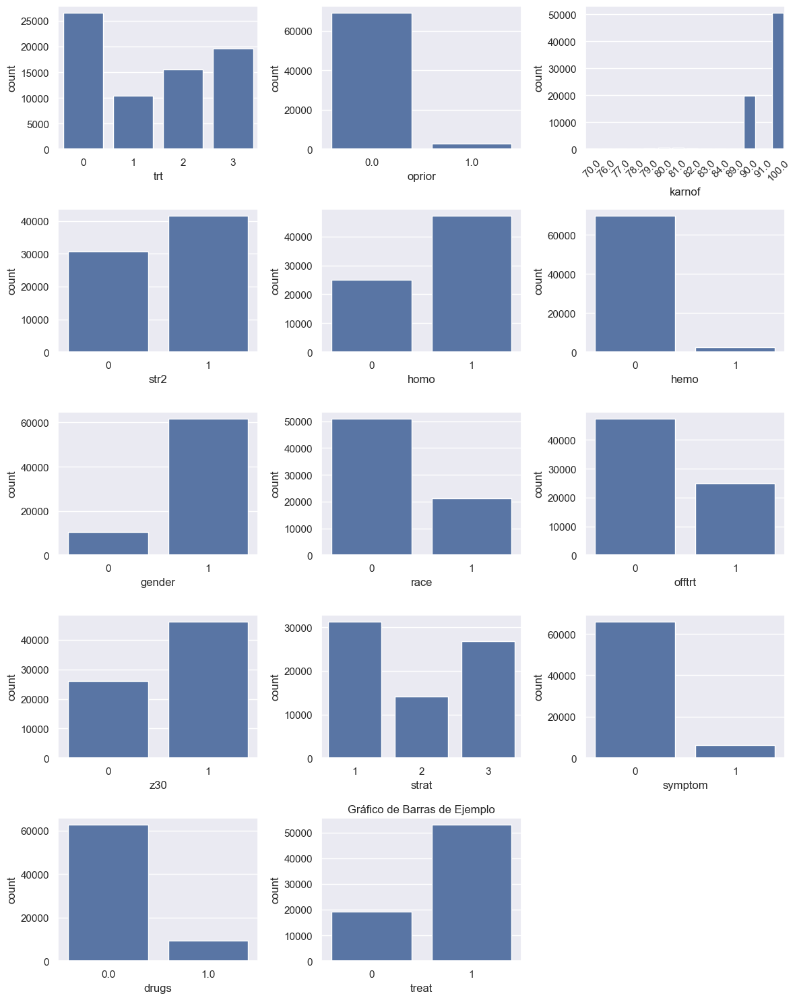

In [48]:
#Grafica de los valores de las variables discretas 
build_bar_plot(aids_df,dis_cols,target_var,'Distribución de las variables categoricas después de la limpieza de los datos')

#### Detección de outliers en variables numericas continuas
Para realizar el analisis de los datos atipicos en las variables numericas continuas tambien se va a usar el rango intercuantilico, el cual es un método excelente para detectar valores atípicos en un conjunto de datos. \
El valor de k usado en este caso es de `k=2`, este valor es debido a que se tiene una gran cantidad de datos de diferente tipo y lo ideal es reducir la sensibilidad en este caso un 0.5, debido a que no son considerados como errores sino casos especiales de los datos.

In [49]:
def detectar_outliers(df,k=1.5):
    outliers = pd.DataFrame(columns=df.columns)
    
    for col in df.columns:
        if pd.api.types.is_numeric_dtype(df[col]):
            Q1 = df[col].quantile(0.25)
            Q3 = df[col].quantile(0.75)
            IQR = Q3 - Q1
            
            limite_inferior = Q1 - k * IQR
            limite_superior = Q3 + k * IQR
            
            outliers_col = df[(df[col] < limite_inferior) | (df[col] > limite_superior)]
            outliers = pd.concat([outliers, outliers_col], axis=0)
    
    return outliers

def eliminar_outliers_iqr_multi(df, columns, k=1.5):
    df_filtrado = df.copy()
    for column in columns:
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - k * IQR
        upper_bound = Q3 + k * IQR
        
        # Filtrar filas que no son outliers en la columna actual
        df_filtrado = df_filtrado[(df_filtrado[column] >= lower_bound) & (df_filtrado[column] <= upper_bound)]
    
    return df_filtrado

def generate_boxplot(data, numerical_cols, title = 'Distribución de Variables Numéricas'):
    # Generar box plots para las variables numéricas
    # Estilo y tamaño del gráfico
    plt.figure(figsize=(8, 6))
    sns.set(style="whitegrid")  # Estilo de fondo del gráficogenerate_boxplot

    # Crear el box plot utilizando Seaborn para una apariencia más elegante
    sns.boxplot(data=data[numerical_cols])
    plt.title(title, fontsize=16, fontweight='bold')
    plt.xlabel('Variables', fontsize=14)
    plt.ylabel('Valor', fontsize=14)
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.tight_layout()

    # Mostrar el gráfico
    plt.show()

df_outliers = detectar_outliers(aids_df[cont_cols],2)
df_outliers

C:\Users\jonat\AppData\Local\Temp\ipykernel_17880\3914221541.py:14: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  outliers = pd.concat([outliers, outliers_col], axis=0)


,time,age,wtkg,preanti,cd40,cd420,cd80,cd820
1,1002.0,61,49.44240,895.0,162.0,218.0,392.0,564.0
49,987.0,67,71.00000,0.0,307.0,376.0,975.0,931.0
100,1180.0,64,77.11200,174.0,383.0,469.0,1430.0,1797.0
104,1101.0,70,73.93680,674.0,429.0,353.0,1121.0,1034.0
170,483.0,65,77.20000,0.0,323.0,412.0,1351.0,1338.0
...,...,...,...,...,...,...,...,...
71867,589.0,36,80.87596,485.0,359.0,466.0,2207.0,3128.0
71894,934.0,35,75.65304,22.0,265.0,295.0,1064.0,2155.0
71904,1141.0,36,73.64727,356.0,348.0,310.0,554.0,2041.0
71918,976.0,23,60.68506,9.0,384.0,527.0,1318.0,2117.0


In [50]:
#Analisis de los datos obtenidos de los outliers
df_outliers.describe()

,time,wtkg,preanti,cd40,cd420,cd80,cd820
count,5932.000000,5932.000000,5932.000000,5932.000000,5932.000000,5932.000000,5932.000000
mean,892.517532,88.571595,419.694707,329.483479,462.972185,1680.984322,1095.126770
std,301.248879,21.843911,583.600609,115.181399,178.070090,898.421449,581.095445
min,96.000000,31.000000,0.000000,0.000000,88.000000,40.000000,124.000000
25%,568.000000,71.153150,0.000000,241.000000,334.000000,824.000000,682.750000
50%,1053.000000,80.291705,61.000000,309.000000,431.000000,1435.000000,927.000000
75%,1139.000000,110.449575,760.000000,404.000000,550.000000,2509.000000,1257.000000
max,1231.000000,159.939360,2851.000000,1199.000000,1119.000000,5011.000000,6035.000000


**Después del analisis realizado de los datos atipicos se puede observar que se tiene una gran diferencia entre los datos en todas las variables, teniendo una desviación estandar alta, además esta cantidad de datos no representa aproximandamente ni el 9% del total de los datos por lo cual se elimina del dataset**

In [51]:
#Eliminación de los outliers del dataframe
aids_df_cle = eliminar_outliers_iqr_multi(aids_df,cont_cols)
aids_df_cle

,time,trt,age,wtkg,hemo,homo,drugs,karnof,oprior,z30,preanti,race,gender,str2,strat,symptom,treat,offtrt,cd40,cd420,cd80,cd820,infected
0,948.0,2,48,89.81280,0,0,0.0,100.0,0.0,0,0.0,0,0,0,1,0,1,0,422.0,477.0,566.0,324.0,0
5,1181.0,1,46,88.90560,0,1,1.0,100.0,0.0,1,1181.0,0,1,1,3,0,1,0,235.0,339.0,860.0,1060.0,0
6,794.0,0,31,73.02960,0,1,0.0,100.0,0.0,1,930.0,0,1,1,3,0,0,0,244.0,225.0,708.0,699.0,1
8,198.0,3,40,82.55520,0,1,0.0,90.0,0.0,1,1074.0,0,1,1,3,1,1,1,214.0,107.0,652.0,131.0,1
9,188.0,0,35,78.01920,0,1,0.0,100.0,0.0,1,964.0,0,1,1,3,0,0,1,221.0,132.0,221.0,759.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72133,952.0,1,27,69.26026,0,1,0.0,100.0,0.0,0,0.0,0,1,0,1,0,0,0,326.0,521.0,826.0,1257.0,0
72134,953.0,3,46,61.28204,0,0,0.0,90.0,0.0,1,1089.0,0,0,1,3,0,1,1,234.0,402.0,481.0,1014.0,0
72135,1036.0,0,42,73.36768,0,1,0.0,100.0,0.0,1,312.0,1,1,1,3,0,0,1,369.0,575.0,514.0,657.0,0
72136,1157.0,0,40,78.75824,0,1,0.0,100.0,0.0,1,0.0,0,1,1,1,0,1,0,308.0,663.0,1581.0,863.0,0


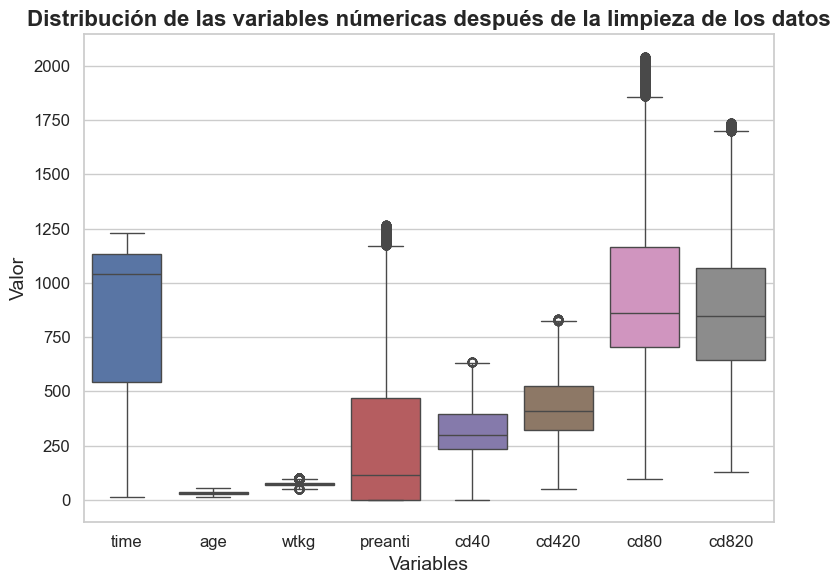

In [52]:
generate_boxplot(aids_df_cle,cont_cols, 'Distribución de las variables númericas después de la limpieza de los datos')

### Integración y Transformación
Se realizan transformaciones, codificación de variables categóricas y selección de características relevantes para el diagnóstico del SIDA.


#### Normalización de los datos
Se va a normalizar los datos de las variables númericas para que los algoritmos no se vean afectado por las escalas, para ello se va a usar RobustScaler que es util para manejar datos atipicos ayudando a manejar mejor los valores extremos de los datos, tomando en cuenta que se teniana algunos valores extremos que no eran incorrectos sino eran datos inusuales dentro del conjunto.

In [53]:
# Inicializar el RobustScaler
scaler = RobustScaler()
aids_df_cle_scaled = aids_df_cle
for col in cont_cols:
    aids_df_cle_scaled[col] = scaler.fit_transform(aids_df_cle_scaled[[col]])

# Ajustar y transformar los datos
aids_df_cle_scaled

,time,trt,age,wtkg,hemo,homo,drugs,karnof,oprior,z30,preanti,race,gender,str2,strat,symptom,treat,offtrt,cd40,cd420,cd80,cd820,infected
0,-0.157095,2,1.4,1.345797,0,0,0.0,100.0,0.0,0,-0.247335,0,0,0,1,0,1,0,0.773585,0.333333,-0.645022,-1.234043,0
5,0.236486,1,1.2,1.270461,0,1,1.0,100.0,0.0,1,2.270789,0,1,1,3,0,1,0,-0.402516,-0.353234,-0.008658,0.505910,0
6,-0.417230,0,-0.3,-0.047928,0,1,0.0,100.0,0.0,1,1.735608,0,1,1,3,0,0,0,-0.345912,-0.920398,-0.337662,-0.347518,1
8,-1.423986,3,0.6,0.743105,0,1,0.0,90.0,0.0,1,2.042644,0,1,1,3,1,1,1,-0.534591,-1.507463,-0.458874,-1.690307,1
9,-1.440878,0,0.1,0.366423,0,1,0.0,100.0,0.0,1,1.808102,0,1,1,3,0,0,1,-0.490566,-1.383085,-1.391775,-0.205674,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72133,-0.150338,1,-0.7,-0.360945,0,1,0.0,100.0,0.0,0,-0.247335,0,1,0,1,0,0,0,0.169811,0.552239,-0.082251,0.971631,0
72134,-0.148649,3,1.2,-1.023480,0,0,0.0,90.0,0.0,1,2.074627,0,0,1,3,0,1,1,-0.408805,-0.039801,-0.829004,0.397163,0
72135,-0.008446,0,0.8,-0.019853,0,1,0.0,100.0,0.0,1,0.417910,1,1,1,3,0,0,1,0.440252,0.820896,-0.757576,-0.446809,0
72136,0.195946,0,0.6,0.427795,0,1,0.0,100.0,0.0,1,-0.247335,0,1,1,1,0,1,0,0.056604,1.258706,1.551948,0.040189,0


#### Códificación de variables categoricas
En este caso el dataset ya tenia variables categoricas codificadas por lo que no es necesario realizar de nuevo dicho analisis, ademas las variables categoricas que se tiene son binarias excepto por la variable trt que indica los tratamientos 

### Relación entre variables
Se realiza los test estadisticos para las diferentes variables con el objetivo de medir la relación entre las variables categoricas y numericas respecto a la variable objetivo.

#### Asociación de variables categoricas de más de dos valores
**H0**: La variable categórica no está asociada. \
**H1**: La variable categórica está asociada con la variable objetivo `infected`. 

Variables categóricas con más de dos categorías son: `trt` y `strat`. \
Para este analisis se usa la prueba estadística **chi-cuadrado** y el valor p para determinar si existe una relación significativa entre las variables categóricas.

In [54]:
for i in ['trt','strat']:
    chi2, pval,_,_ = chi2_contingency(pd.crosstab(aids_df_cle_scaled[i], aids_df_cle_scaled[target_var]))
    print(i, '--->', pval)

trt ---> 1.3481483356959874e-54
strat ---> 0.0


##### Conclusion
Como el valor p es menor que 0.05, rechazaremos la hipótesis nula, por lo tanto `trt` está asociado con la variable objetivo.

#### Asociación de variables categoricas de dos valores
**H0**: La variable categórica no está asociada. \
**H1**: La variable categórica está asociada con la variable objetivo `infected`. \
Variables categoricas con solo dos categoricas:
* `hemo`
* `homo`
* `drugs`
* `oprio`
* `z30`
* `race`
* `gender`
* `str2`
* `symptom`
* `treat`
* `offtrt`

Para este analisis se ocupa la `prueba estadistica de Fisher`, utilizado para determinar si existe una asociación significativa entre dos variables categóricas. Es útil cuando se trabaja con muestras pequeñas o cuando se desea una precisión extrema en el cálculo de los valores de significancia.

In [55]:
for i in ['hemo', 'homo', 'drugs','oprior', 'z30', 'race','gender','str2','symptom','treat','offtrt']:

    hemo_con = pd.crosstab(aids_df_cle_scaled[i], aids_df_cle_scaled['infected'])
    odds_ratio, p_value = fisher_exact(hemo_con)

    print(i)
    print("Odds Ratio:", odds_ratio)
    print("p-value:{value}".format(value = p_value))
    print(" ") 

hemo
Odds Ratio: 1.301768528506754
p-value:1.468538724568811e-08
 
homo
Odds Ratio: 0.9816083823071196
p-value:0.3122910847460817
 
drugs
Odds Ratio: 0.839649700152905
p-value:3.691709560051e-11
 
oprior
Odds Ratio: 1.5370291620838379
p-value:2.9407339802375198e-24
 
z30
Odds Ratio: 3.275149106326397
p-value:0.0
 
race
Odds Ratio: 0.847099263535257
p-value:1.072706310333977e-17
 
gender
Odds Ratio: 0.8807875206870575
p-value:2.183387820259262e-07
 
str2
Odds Ratio: 3.027982650161609
p-value:0.0
 
symptom
Odds Ratio: 1.2413288099092437
p-value:1.7341185545865215e-12
 
treat
Odds Ratio: 0.7838246646632491
p-value:1.7980251005063994e-35
 
offtrt
Odds Ratio: 0.8934366334127506
p-value:1.2779695198447637e-09
 


##### Conclusión
**Valor p:**
hemo, drugs, oprior, z30, race, gender, str2, symptom, treat y offtrt tienen un valor p menor que 0.05, por lo tanto, rechazamos la hipótesis nula y afirmamos que hay una asociación de estas variables con la variable objetivo.
   
**Razón de probabilidades (odds ratio):**
hemo, oprior, z30, str2 y symptom tienen una razón de probabilidades mayor que 1, por lo tanto, podemos concluir que las probabilidades de estar "infectado" son mayores en un grupo en comparación con otro grupo.

Dado estos dos criterios se tomas las variables `hemo, oprior, z30, str2 y symptom` que cumplen ambos criterios por ser valores más significativos.

#### Matriz de correlación para variables númericas
Una matriz de correlación es una tabla que muestra los coeficientes de correlación entre varias variables. Cada celda de la tabla muestra el valor de la correlación entre dos variables diferentes. Los coeficientes de correlación pueden variar entre -1 y 1, donde:

`1`: indica una correlación positiva perfecta. \
`-1`: indica una correlación negativa perfecta. \
`0`: indica que no hay correlación.

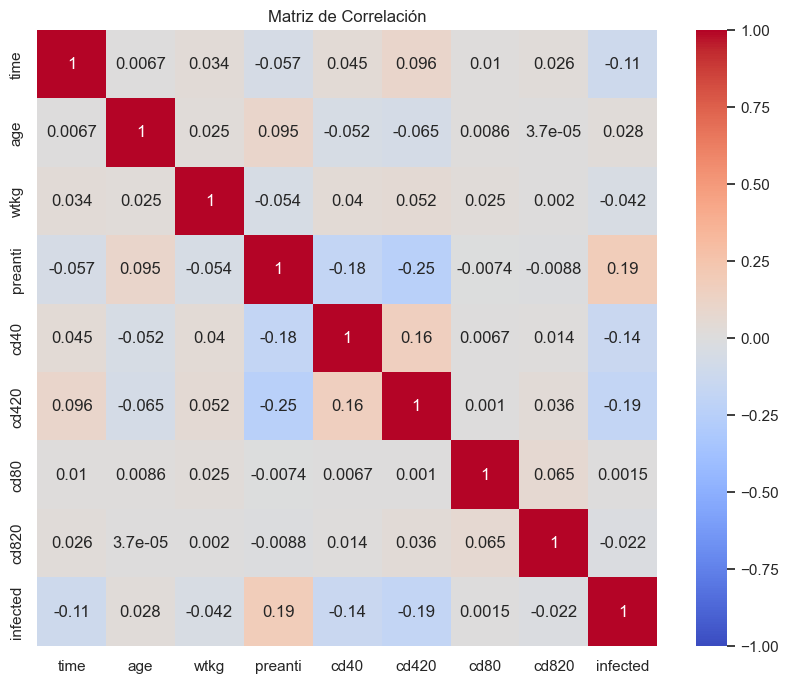

In [56]:
matriz_correlacion = aids_df_cle_scaled[cont_cols+[target_var]].corr()

# Mostrar la matriz de correlación

# Crear un mapa de calor de la matriz de correlación
plt.figure(figsize=(10, 8))
sns.heatmap(matriz_correlacion, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Matriz de Correlación')
plt.show()

##### Conclusión
Analisando los valores obtenidos en la matriz de correlación se pude observar que la variable objetivo tienen valores pequeños por tal motivo se va a seleccionar las variables que representen `time, preanti, cd40, cd420` para el modelo pero para tomar una mejor decisión se va a usar otro método como criterio adicional para analizar la selección de caracteristicas para el modelo de machine learning.

#### Analisis de la multicolinealidad de las variables numericas
Para evaluar las variables se usa VIF (Variance Inflation Factor) para evaluar la multicolinealidad en un modelo de regresión múltiple. La multicolinealidad ocurre cuando dos o más variables predictoras en un modelo están altamente correlacionadas entre sí, lo cual puede ser problemático porque puede llevar a coeficientes de regresión poco fiables y dificultar la interpretación de los efectos individuales de las variables predictoras.
Variables numéricas:
* `time`
* `trt`
* `age`
* `wtkg`
* `preanti`
* `cd40`
* `cd420`
* `cd80`
* `cd820`


In [57]:
vif_data = aids_df_cle_scaled[cont_cols]
#Agregando una columna constante para la intersección
X = sm.add_constant(vif_data)
# Calcula el VIF para cada columna
vif = pd.DataFrame()
vif["Variable"] = X.columns
vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

# Mostar los valores de VIF
print(vif)

  Variable       VIF
0    const  1.784425
1     time  1.012803
2      age  1.013325
3     wtkg  1.007554
4  preanti  1.098872
5     cd40  1.053083
6    cd420  1.092063
7     cd80  1.005095
8    cd820  1.006156


##### Conclusión
**Al tener valore de 1 en cada una de las variables evaluadas indica la ausencia de multicolinealidad, por lo cual las variables son independientes unas de otras**

#### Logistic Regression empleado para variables numericas
Logistic regresion es un modelo de machine learning que nos permite modelar la probabilidad de que ocurra un evento dado un conjunto de variables predictoras. Es particularmente útil cuando la variable dependiente es binaria (sí/no, 0/1) o de naturaleza categórica ordinal.

En nuestro caso necesitamos el valor de p (`P>|z|` en el resumen del modelo) con su significancia para determinar si una variable es significativa en el modelo de regresión logística, evalúa el valor de p asociado con cada coeficiente estimado. Un valor de p pequeño (generalmente menor que 0.05) indica que la variable independiente tiene una asociación significativa con la variable dependiente. Esto significa que la variable contribuye de manera significativa a explicar la variabilidad en la variable dependiente, después de controlar otras variables en el modelo.


In [58]:
X = sm.add_constant(aids_df_cle_scaled[cont_cols])
y = aids_df_cle_scaled['infected']
# Enternar el modelo logistic regression
model = sm.Logit(y, X).fit()
# Imprimir el resumen del modelo con los valores que aportan a predecir la variable infected
print(model.summary())

Optimization terminated successfully.
         Current function value: 0.582781
         Iterations 5
                           Logit Regression Results                           
Dep. Variable:               infected   No. Observations:                60611
Model:                          Logit   Df Residuals:                    60602
Method:                           MLE   Df Model:                            8
Date:                Fri, 28 Jun 2024   Pseudo R-squ.:                 0.06065
Time:                        01:57:39   Log-Likelihood:                -35323.
converged:                       True   LL-Null:                       -37604.
Covariance Type:            nonrobust   LLR p-value:                     0.000
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -1.0076      0.012    -81.103      0.000      -1.032      -0.983
time          -0.3722      0.

##### Conclusión de variables numericas
Analisando los valores de P>∣z∣ se observa de que existen varios predictore (time, wtkg, preanti, cd40, cd820 y cd420) que son estadisticamente significantes, mientras que predictores como age, and cd80 no son significantes por ser superiores a la convención 0.05. Ademas en el analisis anterior la matriz de correlación se obtuvieron las siguientes variables time, preanti, cd40, cd420 por lo que se va a hacer la intersección de ambos métodos para la seleccion de las variables de machine learning.\
**Las variables numericas seleccionas para el uso en el modelo de machine learning son las siguientes time, preanti, cd40, cd420.**

#### Conclusión de la relación entre variables
Al tener muchas variables dentro del dataset se priorizó realizar un analisis, para tener solo aquellas variables que sean estadisticamente significantes para el modelo de clasificación en torno a la variable de predicción `infected`, las variables a ser usadas en los analisis posteriores son las siguientes: 
* `trt`
* `hemo`
* `oprior`
* `z30`
* `str2`
* `symptom`
* `time`
* `preanti`
* `cd40`
* `cd420`

In [59]:
#Variables del dataset a analizar 
analysis_var = ['trt','hemo','oprior','z30','str2','symptom','time','preanti','cd40','cd420']

# Fase 4: Modelado

## Preparación de los datos antes del entrenamiento
En analisis anteriores se detecto que los datos estaban desbalanceados es por esta razón que en esta etapa se va a realizar el tratamiento de ese desbalanceo. 

C:\Users\jonat\AppData\Local\Temp\ipykernel_17880\2933708579.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(x=target_var, data=aids_df_cle_scaled, palette='pastel')


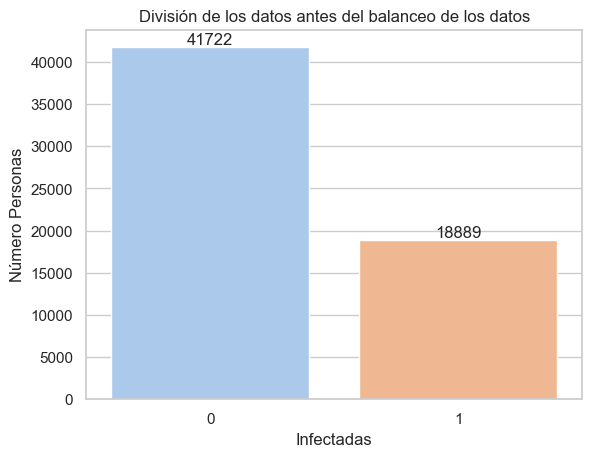

In [60]:
ax = sns.countplot(x=target_var, data=aids_df_cle_scaled, palette='pastel')
plt.title('División de los datos antes del balanceo de los datos')
plt.xlabel('Infectadas')
plt.ylabel('Número Personas')
# Añadir anotaciones
for container in ax.containers:
    ax.bar_label(container, label_type='edge')
plt.show()

### SMOTEENN para el balanceo de los datos
El algoritmo SMOTEENN combina dos técnicas de balanceo de clases: SMOTE (Synthetic Minority Over-sampling Technique) y ENN (Edited Nearest Neighbors). Está diseñado para abordar el desequilibrio de clases en conjuntos de datos de clasificación binaria.\
Primero aplica SMOTE para generar muestras sintéticas de la clase minoritaria, lo que aumenta su tamaño.
Luego aplica ENN para eliminar ejemplos de la clase mayoritaria que están cerca de la frontera de decisión con la clase minoritaria, lo que reduce su tamaño.

In [61]:
#División de las caracteristicas y la variable objetivo
X = aids_df_cle_scaled[analysis_var]
y = aids_df_cle_scaled[target_var]

smote_enn = SMOTEENN(random_state=42)
X_resampled, y_resampled = smote_enn.fit_resample(X, y)

y_resampled.value_counts()

infected
1    21557
0    15739
Name: count, dtype: int64

C:\Users\jonat\AppData\Local\Temp\ipykernel_17880\453652508.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(x=y_resampled, data=X_resampled, palette='pastel')


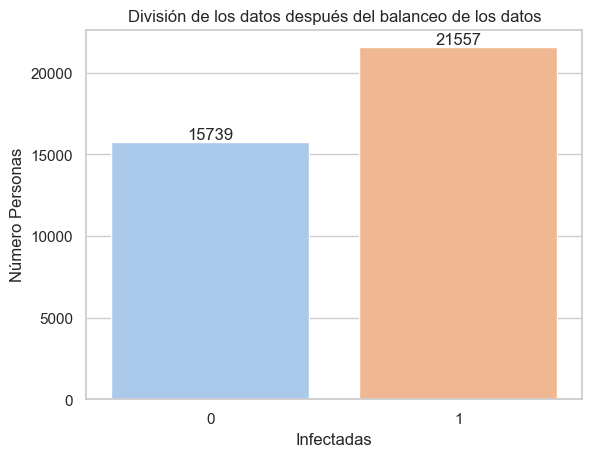

In [62]:
ax = sns.countplot(x=y_resampled, data=X_resampled, palette='pastel')
plt.title('División de los datos después del balanceo de los datos')
plt.xlabel('Infectadas')
plt.ylabel('Número Personas')
# Añadir anotaciones
for container in ax.containers:
    ax.bar_label(container, label_type='edge')
plt.show()

#### Conclusión 
Los datos estaban desbalanceados por lo que se aplico SMOTEENN para realizar el blanceo lo cual elimino ejemplos de la clase mayoritaria que son considerados ruido o que están mal clasificados por sus vecinos más cercanos siendo una tecnica poderosa para manejar el desequilibrio de clases en conjuntos de datos de clasificación binaria.

### División de los datos de entramiento y prueba
La división de un conjunto de datos en conjuntos de entrenamiento y prueba es esencial esencial en el aprendizaje automatico para evaluar la capacidad de generalizar de un modelo. En este caso se va dividir los datos en 75% entrenamiento y 25% prueba

In [63]:
# Dividir los datos en conjunto de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.20, random_state=42)

#### Coclusión
El realizar el balanceo de los datos permite que al entrenar los modelos estos no sufran de sobreajuste haciendo que el modelo sea bueno solo prediciendo la clase con más datos.

## Entrenamiento de lo modelos
Entrenar modelos y ajustar los hiperparámetros para optimizar el rendimiento del modelo en términos de precisión y sensibilidad en la detección de pacientes con SIDA.

### Selección de Modelos
En esta sección se va a seleccionar 2 modelos de machine learning dando una breve explicación de su funcionamiento y el motivo por el que fueron seleccionados para posteriormente seleccionar el mejor modelo que se adapte a los datos.

#### Regresión Logística

**Descripción:**
La regresión logística es un algoritmo de clasificación binaria que modela la probabilidad de que una instancia pertenezca a una clase particular. Utiliza la función sigmoide para transformar una combinación lineal de las características en una probabilidad.

**Funcionamiento:**
- La función sigmoide se aplica a la combinación lineal de las características.
- El resultado de la función sigmoide es una probabilidad entre 0 y 1.
- Se clasifica la instancia en una clase u otra dependiendo de un umbral, usualmente 0.5.

**Ventajas:**
- Fácil de interpretar y de implementar.
- Rápido y eficiente con grandes conjuntos de datos.
- Proporciona probabilidades como salida, lo cual es útil para la toma de decisiones basada en riesgo.

**Desventajas:**
- No maneja bien relaciones no lineales.
- Sensible a outliers (valores atípicos). 

`Este modelo de machine learning se seleccionó debido a que actua de una buena manera para los modelos de clasifiación binaria como en este caso, ademas en paso previos se realizo la limpieza de los outliers, normalización de los datos y en analisi de colinealidad de los datos por lo que es un buen candidato.`

#### Árboles de Decisión

**Descripción:**
Los árboles de decisión son modelos basados en reglas que dividen iterativamente el espacio de características en subconjuntos más pequeños, creando una estructura similar a un árbol. Cada nodo interno representa una prueba sobre una característica, cada rama representa el resultado de la prueba, y cada hoja representa una clase.

**Funcionamiento:**
- Se selecciona la característica que mejor divide los datos (mediante criterios como la ganancia de información, el índice de Gini, etc.).
- Se crean ramas para cada posible valor o rango de la característica.
- El proceso se repite recursivamente para cada subconjunto resultante hasta que se alcance un criterio de parada (como una profundidad máxima o un número mínimo de muestras en una hoja).

**Ventajas:**
- Fácil de interpretar y visualizar.
- No requiere preprocesamiento de los datos (como la normalización o escalado de características).
- Puede manejar características categóricas y numéricas.

**Desventajas:**
- Propenso al sobreajuste (overfitting) si no se poda adecuadamente.
- Sensible a pequeñas variaciones en los datos (alta varianza).
- No es tan eficiente en términos de precisión como otros modelos más complejos.

`La seleccion de este algoritmo fue debido a que se puede dar una interpretación sencilla y visual de las relaciones de las variables del model frente a la variable objetivo, permite tener caracteristicas categóricas y numéricas, ademas de permitir la relación no lineal. Los datos de analisis para usar este algoritmo son bastante flexibles por lo que no requiere una analisis intensivo, ademas de permitir datos con ruido y valores faltante.`


### Búsqueda de los mejores hiperparámetros para cada modelo 
Encontrar los mejores hiperparámetros para un modelo de aprendizaje automático es crucial para optimizar su rendimiento. Los hiperparámetros son configuraciones que no se aprenden directamente del modelo durante el entrenamiento para ello se va a hacer uso de la libreria GridSearchCV adicionalmente se va a usar la validación cruzada para evaluar los modelos de manera robusta y seleccionar parametros de manera optima.

In [64]:
# Definir los modelos y los hiperparámetros a probar
def train_models(X_train,y_train,cv):
    models = {
        'Regresión Logística': (LogisticRegression(), {
            'C': [0.001, 0.01, 0.1, 1, 10, 100, 200,500],  # Regularización
            'solver': ['liblinear', 'lbfgs', 'saga']
        }),
        'Árboles de Decisión': (DecisionTreeClassifier(random_state=42), {
        'criterion': ['gini', 'entropy'],
        'splitter': ['best', 'random'],
        'max_depth': [None, 10, 20, 30],
        'min_samples_split': [2, 5, 10],
        'min_samples_leaf': [1, 2, 4],
        'max_features': ['sqrt', 'log2', None]
        })
    }
    
    # Realizar búsqueda grid con validación cruzada para cada modelo
    for model_name, (model, param_grid) in models.items():
        grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=cv, scoring='accuracy',n_jobs=-1)
        grid_search.fit(X_train, y_train)
        
        # Mostrar los mejores hiperparámetros encontrados
        print(f"Mejores hiperparámetros para {model_name}:")
        print(grid_search.best_params_)
        
        # Mostrar la precisión media de validación cruzada para el mejor modelo
        print(f"Precisión media de validación cruzada para {model_name}: {grid_search.best_score_}")
        print()

In [65]:
# Definir el método de validación cruzada, KFold en este caso
cv = KFold(n_splits=5, shuffle=True, random_state=42)
#Buscar los mejores valore para los modelos seleccionados
train_models(X_train,y_train,cv)

Mejores hiperparámetros para Regresión Logística:
{'C': 0.01, 'solver': 'saga'}
Precisión media de validación cruzada para Regresión Logística: 0.8054028782521924

Mejores hiperparámetros para Árboles de Decisión:
{'criterion': 'entropy', 'max_depth': None, 'max_features': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'splitter': 'random'}
Precisión media de validación cruzada para Árboles de Decisión: 0.8519233633509773



#### Conclusión
La busqueda de los hiperparametros se ha realizado de manera correcta dando un resultado de accuracy bueno alredero de 70% pero antes de tomar una de decisión se va a entrenar a los modelos y ser evaluados con las diferentes metricas.

### Entrenamiento de los modelos
En esta etapa vamos a entrenar a los modelos usando la validación cruzada

In [66]:
#Instancia de los modelos con los hiperaparametros calculados previamente
logistic_regresion = LogisticRegression(C=0.01, solver='saga')
decision_tree = DecisionTreeClassifier(criterion='entropy',max_depth=None,max_features=None,min_samples_leaf=1, min_samples_split=2,splitter='random')

In [67]:
#Entrenar el modelo
logistic_regresion.fit(X_train,y_train)
decision_tree.fit(X_train,y_train)

DecisionTreeClassifier(criterion='entropy', splitter='random')

# Fase 5: Evaluación y Despliegue

## Evaluación del Modelo
Evaluar el modelo final utilizando métricas de rendimiento como precisión, recall y F1-score, asegurando que cumpla con los criterios de éxito definidos en la fase de definición del problema.


In [68]:
def evaluate_performance(Model, Xtrain, Xtest, Ytrain, Ytest):
    
    overall_score = cross_val_score(Model, Xtrain,Ytrain, cv=10)
    model_score = np.average(overall_score)
    Ypredicted = Model.predict(Xtest)
    roc_auc = roc_auc_score(Ytest, Ypredicted)
    avg = 'weighted'
    print("\n • Training Accuracy Score : ", round(Model.score(Xtrain, Ytrain) * 100,2))
    print(f" • Cross Validation Score : {round(model_score * 100,2)}")
    print(f" • Testing Accuracy Score :{round(accuracy_score(Ytest, Ypredicted) * 100,2)}")
    print(f" • Precision Score is : {np.round(precision_score(Ytest, Ypredicted , average=avg) * 100,2)}")
    print(f" • Recall Score is : {np.round(recall_score(Ytest, Ypredicted , average=avg) * 100,2)}")
    print(f" • F1-Score Score is : {np.round(f1_score(Ytest, Ypredicted , average=avg) * 100,2)}")
    print(f' • ROC AUC Score: {roc_auc:.2f}')

def display_confusion_matrix(model,X_test,y_test):
    # Hacer predicciones en el conjunto de prueba
    y_pred = model.predict(X_test)
    # Generar la matriz de confusión
    cm = confusion_matrix(y_test, y_pred)
    conf_matrix = confusion_matrix(y_test, y_pred)
    # Visualizar la matriz de confusión
    disp = ConfusionMatrixDisplay(confusion_matrix=cm)

    # Configurar el gráfico
    disp.plot(cmap=plt.cm.Blues)
    plt.title('Matriz de Confusión')
    plt.show()

def plot_roc_curve(Model, Xtrain, Xtest, Ytrain, Ytest):
    Ypredicted = Model.predict(Xtest)
    roc_auc = roc_auc_score(Ytest, Ypredicted)
    fpr, tpr, thresholds = roc_curve(Ytest, Ypredicted)
    # Plotear la curva ROC
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], linestyle='--', color='grey', label='Random Guessing')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend()
    plt.grid(True)
    plt.show()

### Evaluación del modelo de regresión lineal

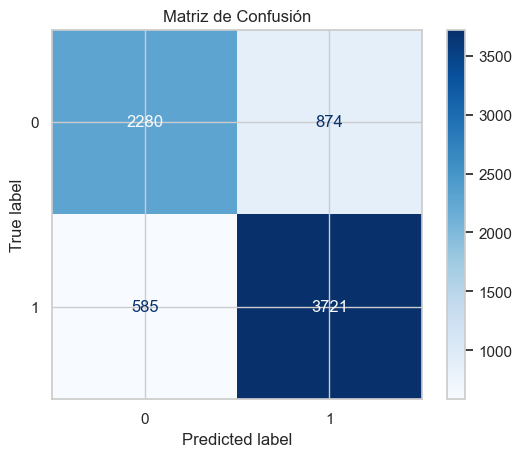

In [69]:
display_confusion_matrix(logistic_regresion,X_test,y_test)

In [70]:
evaluate_performance(logistic_regresion, X_train, X_test, y_train, y_test)


 • Training Accuracy Score :  80.54
 • Cross Validation Score : 80.56
 • Testing Accuracy Score :80.44
 • Precision Score is : 80.39
 • Recall Score is : 80.44
 • F1-Score Score is : 80.29
 • ROC AUC Score: 0.79


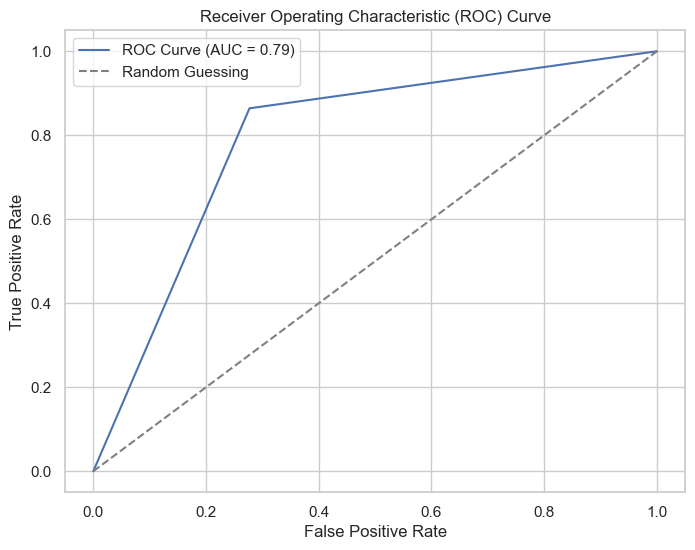

In [71]:
plot_roc_curve(logistic_regresion, X_train, X_test, y_train, y_test)

### Evaluación del modelo de arboles de decisión

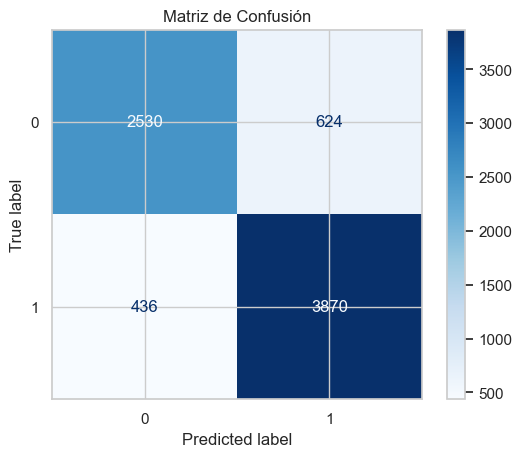

In [72]:
display_confusion_matrix(decision_tree,X_test,y_test)

In [73]:
evaluate_performance(decision_tree, X_train, X_test, y_train, y_test)


 • Training Accuracy Score :  100.0
 • Cross Validation Score : 85.42
 • Testing Accuracy Score :85.79
 • Precision Score is : 85.77
 • Recall Score is : 85.79
 • F1-Score Score is : 85.72
 • ROC AUC Score: 0.85


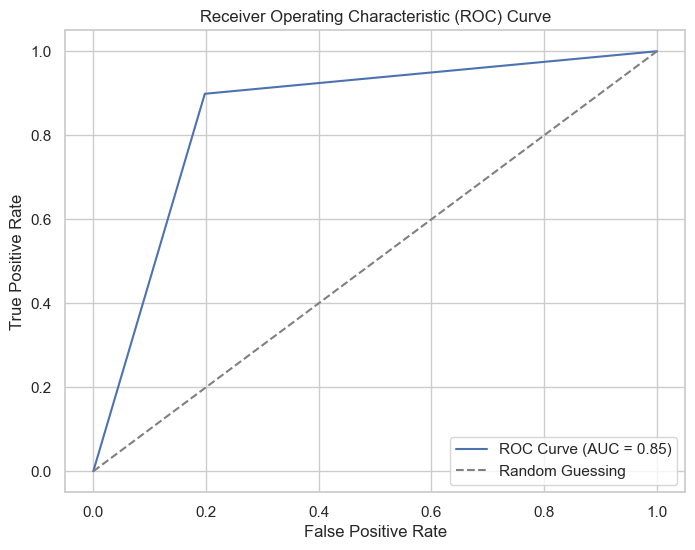

In [74]:
plot_roc_curve(decision_tree, X_train, X_test, y_train, y_test)

## Conclusión en la seleccion del modelo
Anteriormente se menciono que no se tenia un criterio formado para poder tomar una decisión pero luego de analizar los modelos de clasificación binaria se concluye que de los dos algoritmos seleccionados el mejor es el `árbol de decisión`, por lo que se va a realizar un análisis detallado de dicho modelo. \
`Matriz de confusión`: La matriz nos muestra que de 7159 registros usados para la predicción 1058 registros no fueron predecidos de manera correcta, lo cual puede ser considerado como un buen modelo de predicción. \
`Training Accuracy Score`: El valor de 100% nos indica que el modelo ha aprendido perfectamente los datos de entrenamiento y puede predecirlos sin error, sin embargo un valor tan alto puede indicar que el modelo podria tener un sobreajuste. \
`Cross Validation Score`: La validación cruzada nos proporciona información importante para evaluar la capacidad de generalizar un modelo y en este caso tenemos un valor de 85.36% lo que sugiere que el modelo tiene un buen rendimiento en datos no vistos. \
`Testing Accuracy Score`: El score indica la precisión de los datos con el conjunto de prueba que no se utilizo durante el entrenamiento ni la validación. \
`Precision Score`: La precisión se refiere a la proporción de predicciones positivas correctas (verdaderos positivos) que en este caso se tiene una precisión de 85.82% lo cual es bueno. \
`Recall Score`: Mide la proporción de verdaderos positivos que fueron correctamente identificados por el modelo sobre el total de positivos reales en los datos con un valor de 85.82% indica que el modelo identificó correctamente. \
`F1-Score`: Un puntaje F1 del 85.74% indica un buen equilibrio entre precisión y exhaustividad del modelo. \
`ROC AUC Score`: Un valor de ROC AUC Score de 0.85 indica que el modelo tiene un buen rendimiento en la clasificación y es capaz de ditinguir entre las clases positivas y negativas en un 85%. \
Ademas el modelo de arboles de decisión nos permite conocer cuales son los criterios para clasificar proporcionando un gran entendimiento de su funciónamiento y entendimiento, como se muestra a continuación.

In [75]:
#Se grafica los criterios de clasificación del modelo
dot_data = tree.export_graphviz(decision_tree, out_file=None, 
                                feature_names = analysis_var,  
                                filled=True)

# Draw graph
graph = graphviz.Source(dot_data, format="png") 
graph

In [76]:
graph.render("decision_tree_graphivz")

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.127922 to fit


'decision_tree_graphivz.png'

## Uso del modelo para la clasificación de pacientes
El uso de un modelo de clasificación en el contexto de pacientes con SIDA puede ser muy relevante para diversas aplicaciones en medicina y salud pública entre algunas de ellas tenemos:
- **Diagnóstico temprano:** Identificación temprana de la infección por VIH.
- **Predicción de progresión:** Pronóstico de la velocidad de progresión del VIH al SIDA.
- **Pronóstico y calidad de vida:** Predicción del pronóstico a largo plazo y calidad de vida. \
Finalmente los modelos de clasificación ofrecen herramientas para mejorar la atención médica y la gestión de pacientes con SIDA, facilitando diagnósticos más precisos, tratamientos personalizados y predicciones de resultados de salud.

## Despliegue del Modelo (No realizable en las actividades planteadas)
Implementar el modelo en un entorno de producción clínica, integrándolo con sistemas de información médica existentes y asegurando su interoperabilidad y seguridad.


# Fase 6: Monitoreo y Mantenimiento (No realizable en las actividades planteadas)


## Monitoreo Continuo (No realizable en las actividades planteadas)
Establecer un sistema para monitorear el rendimiento del modelo en producción, identificar posibles desviaciones y actualizar el modelo según sea necesario para mantener su precisión y relevancia en el diagnóstico del SIDA.


# Ciclo de Mejora Continua

## Iteración y Mejora 
Para una proxima iteración del algoritmo es recomendable recopilar más datos de ambas clasificaciones debido a que el dataset se encontraba desbalanceado lo que ocasionaba que el entrenamiento no fuera tan bueno pero aplicando SMOTEENN para el balanceo de los datos mostro resultados bastante buenos haciendo que el modelo mejor significativamente.
